In [1]:
import torch
import sys
import scanpy as sc
import os
sys.path.append(os.path.abspath("FRLC"))
import FRLC
import FRLC_multimarginal
import importlib
import HiddenMarkovOT
from util_LR import convert_adata

In [2]:

device = 'cpu'
dtype=torch.float32


In [3]:

def generate_gaussian_mixture(n_top, n_bottom, mean_top, mean_bottom, cov1, cov2, shift, plotting=True):
    """Generates Gaussian mixture datasets X and Y"""
    X_top = np.random.multivariate_normal(mean_top, cov1, size=n_top)
    X_bottom = np.random.multivariate_normal(mean_bottom, cov2, size=n_bottom)
    Y_top = np.random.multivariate_normal(mean_top + shift, cov1, size=n_top)
    Y_bottom = np.random.multivariate_normal(mean_bottom + shift, cov2, size=n_bottom)
    
    X = np.vstack((X_top, X_bottom))
    Y = np.vstack((Y_top, Y_bottom))
    true_labels = np.hstack((np.zeros(n_top), np.ones(n_bottom)))

    if plotting:
        
        plt.figure(figsize=(8, 6))
        plt.scatter(X[:, 0], X[:, 1],  c=true_labels, alpha=0.7, label='Dataset X')
        plt.scatter(Y[:, 0], Y[:, 1], alpha=0.7, label='Dataset Y', marker='^')
        
        plt.title('Two Pairs of 2D Gaussians')
        plt.xlabel('X coordinate')
        plt.ylabel('Y coordinate')
        plt.legend()
        plt.grid(True)
        plt.show()
    
    return X, Y, true_labels

def apply_gmm_clustering(X, true_labels):
    """Applies Gaussian Mixture Model (GMM) clustering and computes AMI, ARI."""
    gmm = GaussianMixture(n_components=2, covariance_type='full') # , random_state=42
    gmm.fit(X)
    gmm_labels = gmm.predict(X)
    
    ami_score = adjusted_mutual_info_score(true_labels, gmm_labels)
    ari_score = adjusted_rand_score(true_labels, gmm_labels)
    
    return ami_score, ari_score

def apply_frlc_clustering(X, Y, true_labels, device, gamma=40, tau_out=1000000, alpha=0.0, tau_in=1000000, gQ=None, gR=None):
    """Applies FRLC clustering and computes AMI, ARI."""
    
    X1, X2 = torch.from_numpy(X).double().to(device), torch.from_numpy(Y).double().to(device)
    C12 = (torch.cdist(X1, X2) ** 2).float().to(device)
    C12 /= C12.max()

    # Usually, recommend initialization='Full', but that is a randomized init.
    # Rank-2 is effectively deterministic, so take randomness over Gaussian mixtures instead.
    
    Q, R, _, _ = FRLC.FRLC_LR_opt(
        (C12, torch.eye(C12.shape[1]).float().to(device)), None, None,
        r=2, max_iter=20, device=device, returnFull=False,
        alpha=alpha, min_iter=20, tau_out=tau_out, tau_in=tau_in, gamma=gamma,
        dtype=torch.float32, init_args=(None, None, None), printCost=False,
        _gQ=gQ, _gR=gR, initialization='Rank-2')
    
    pred_labels = torch.argmax(Q, axis=1).cpu().numpy()
    ami_score = adjusted_mutual_info_score(true_labels, pred_labels)
    ari_score = adjusted_rand_score(true_labels, pred_labels)
    
    return ami_score, ari_score


In [4]:
import objective_grad
import clustering
import HiddenMarkovOT
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import adjusted_mutual_info_score, adjusted_rand_score
from sklearn.mixture import GaussianMixture
sys.path.insert(0, '/home/ph3641/HMOT/FRLC/')
import importlib
import FRLC
importlib.reload(FRLC)

<module 'FRLC' from '/home/ph3641/HMOT/FRLC/FRLC.py'>

Processing z = 0.0


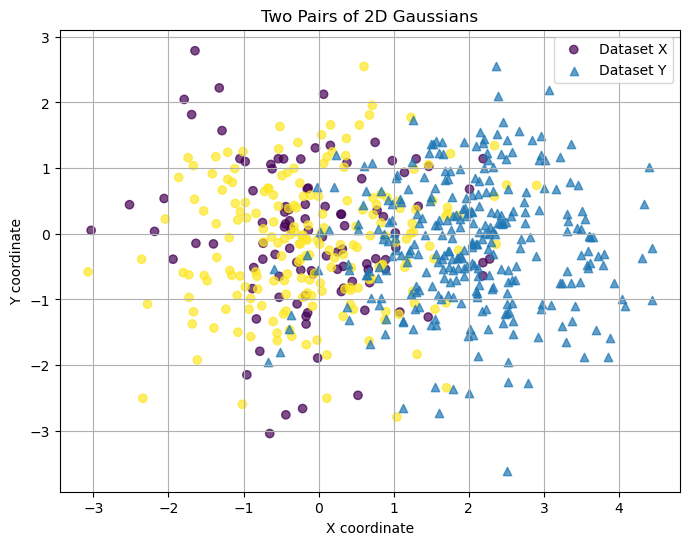

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


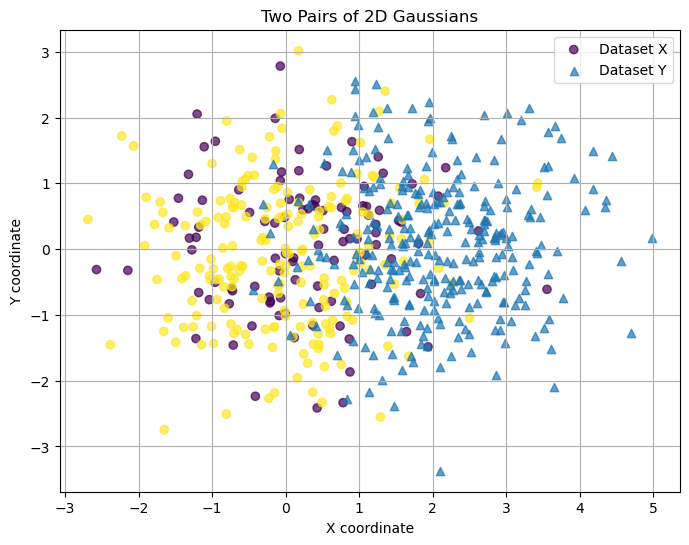

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


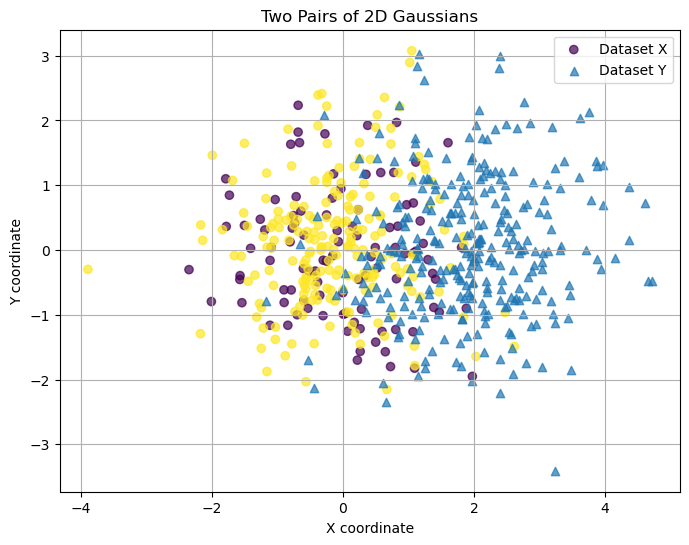

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


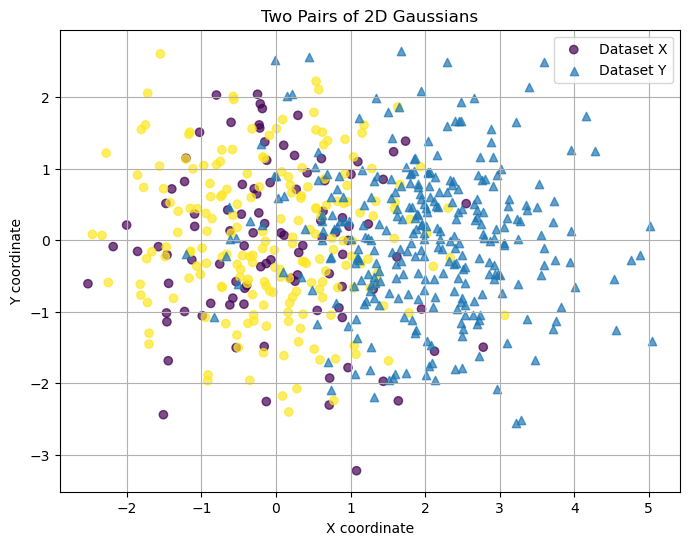

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


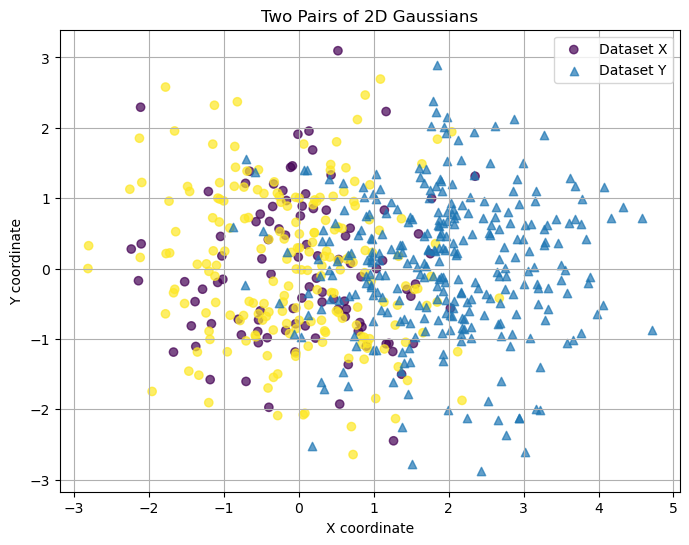

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


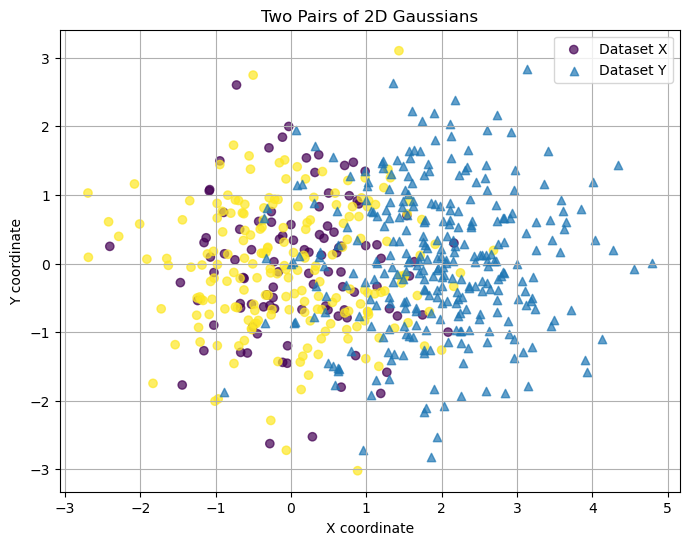

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


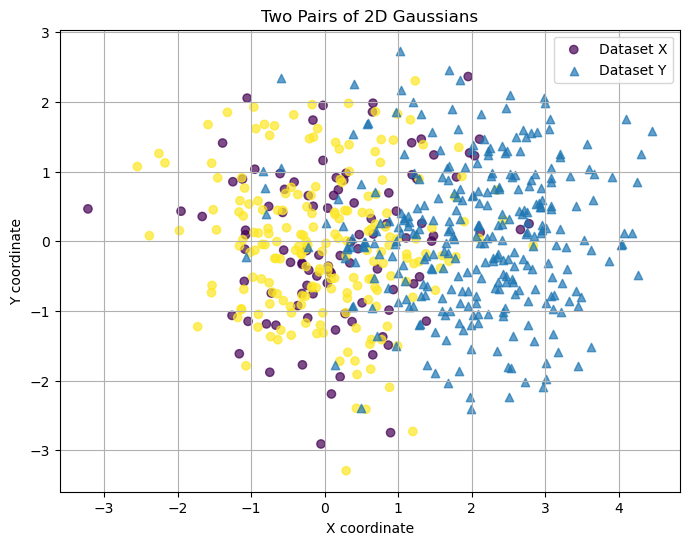

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


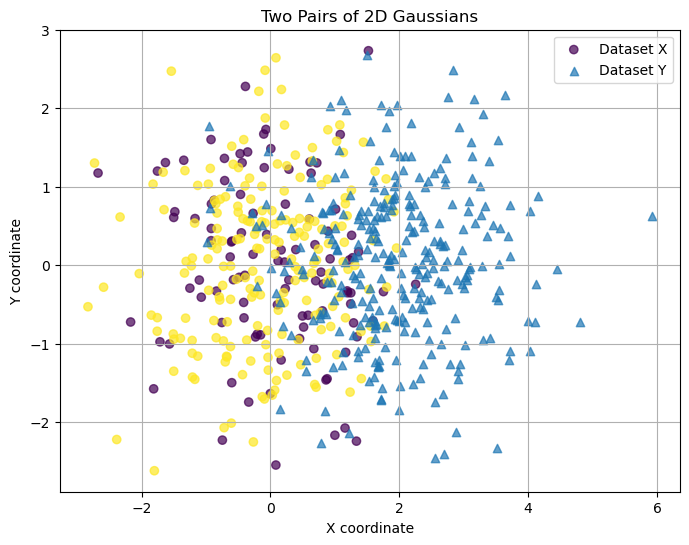

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


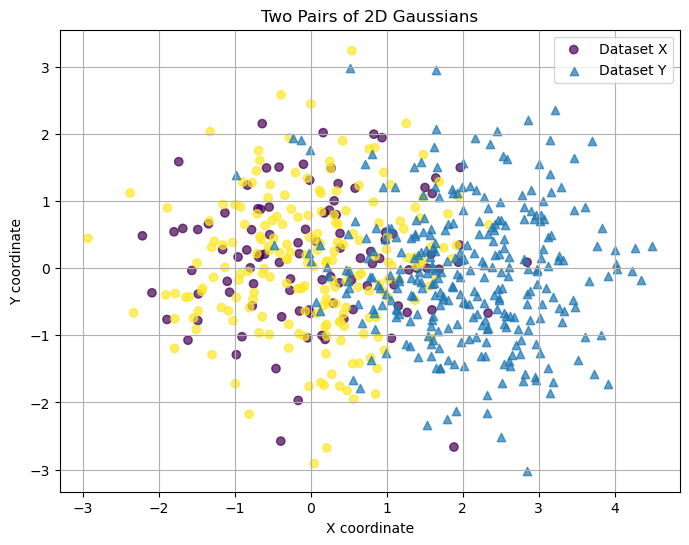

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


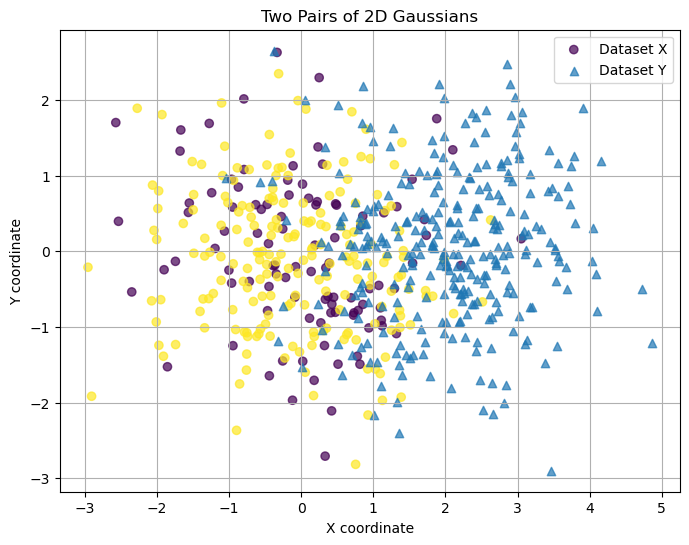

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Processing z = 1.0


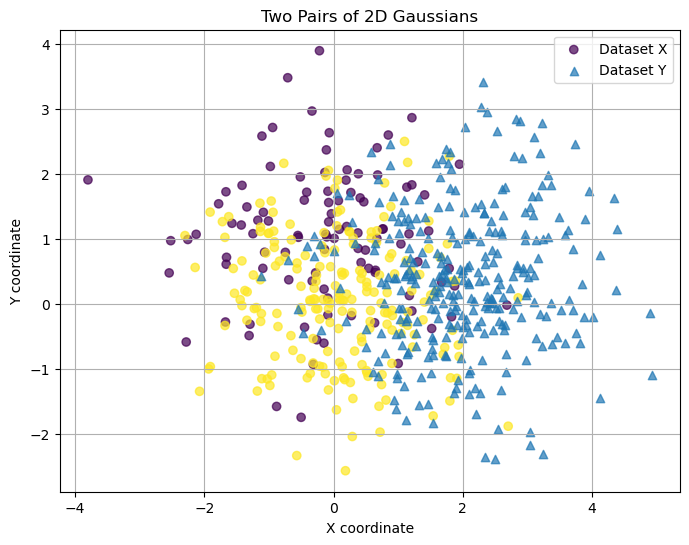

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


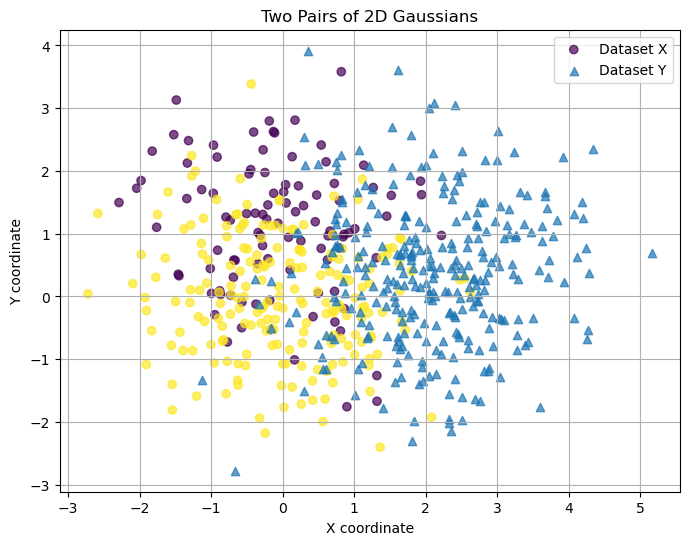

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


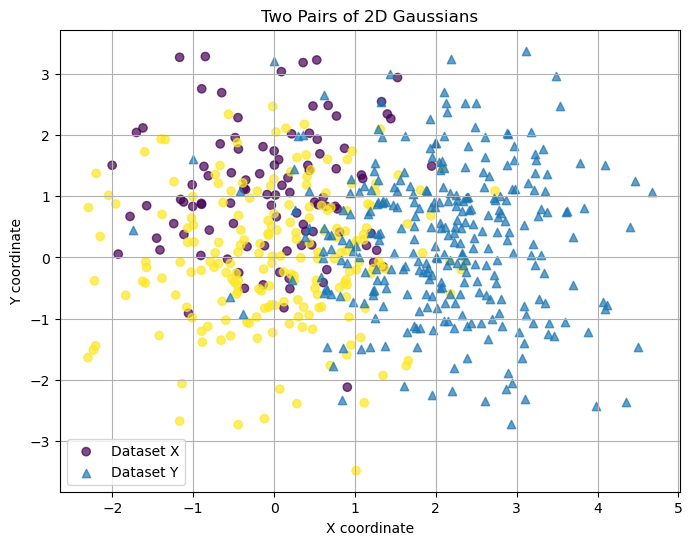

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


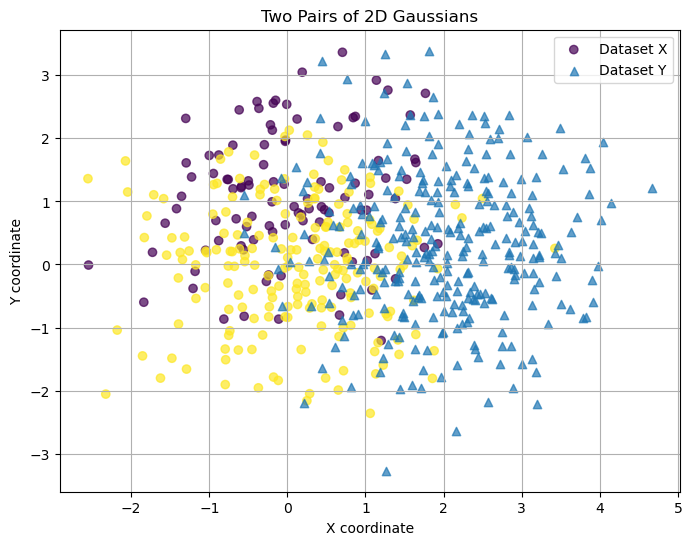

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


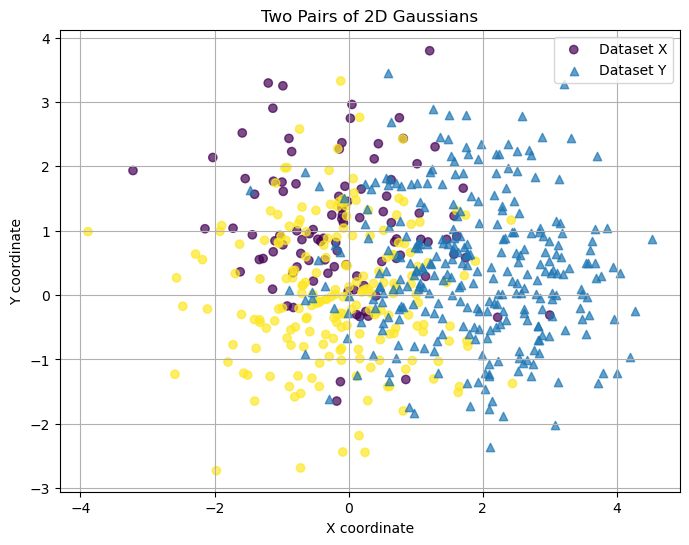

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


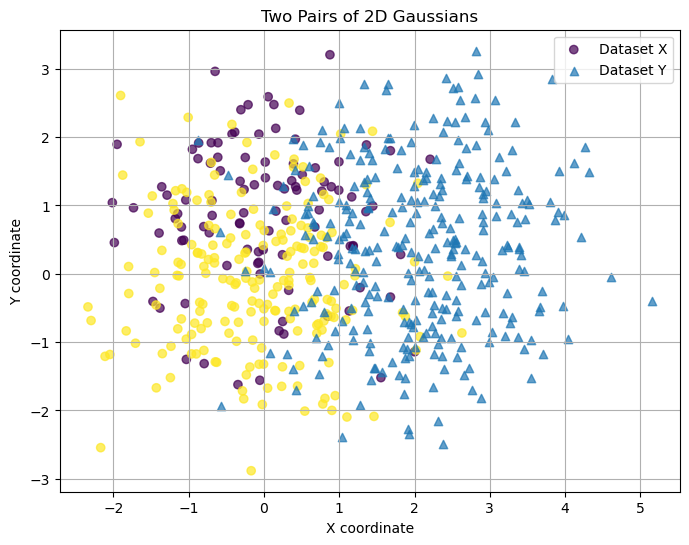

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


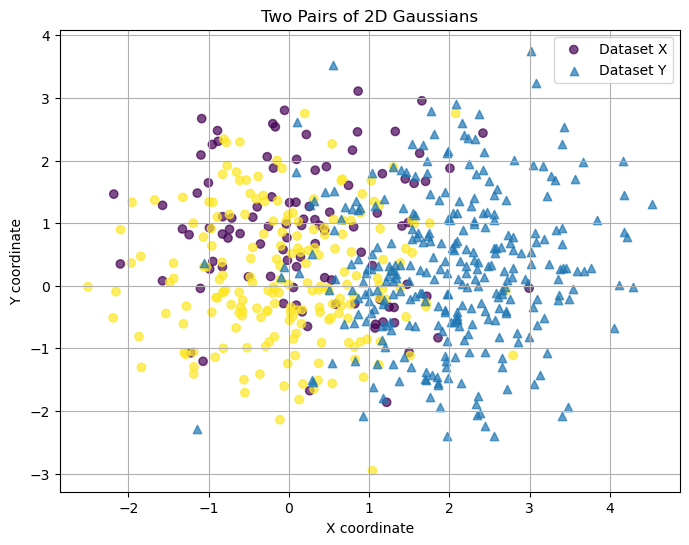

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


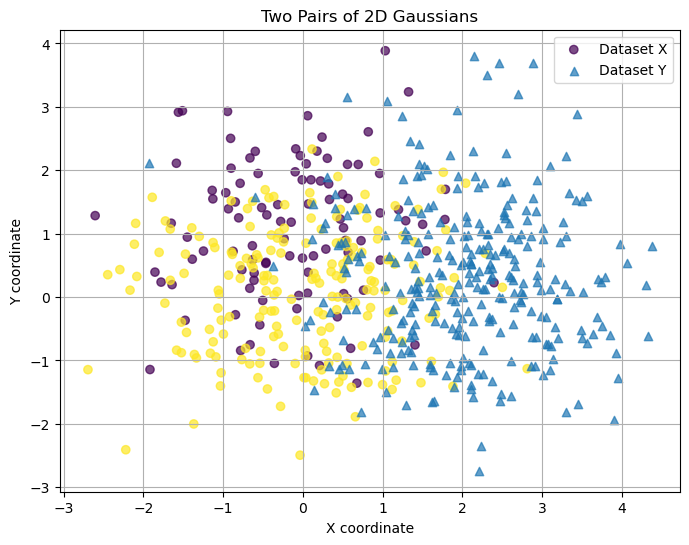

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


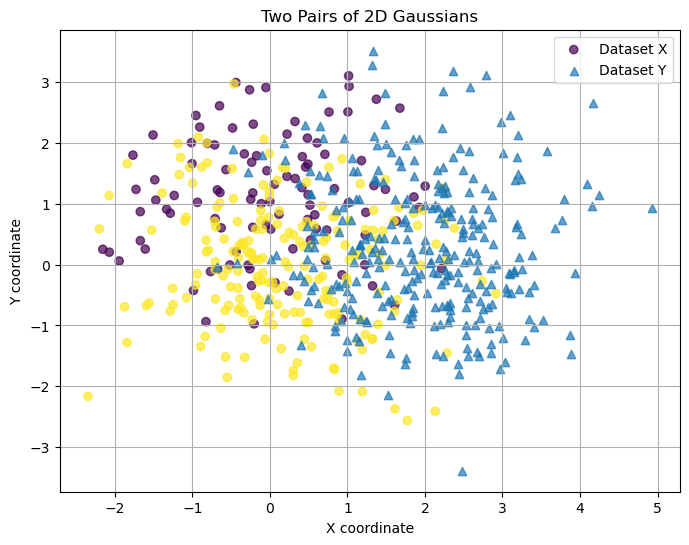

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


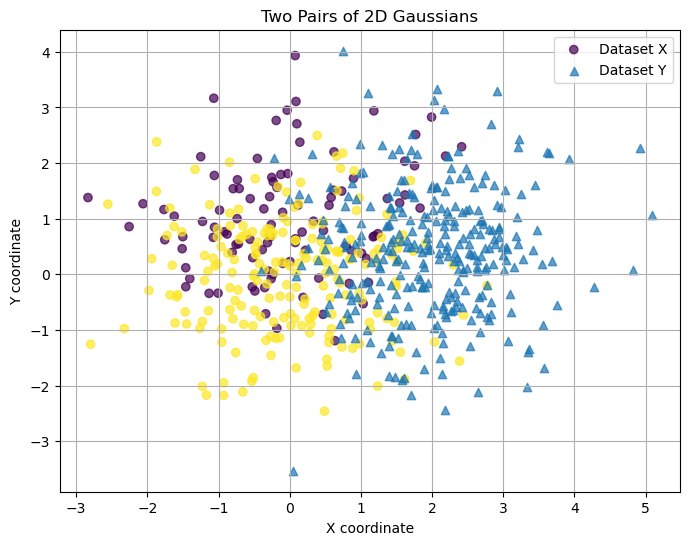

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Processing z = 2.0


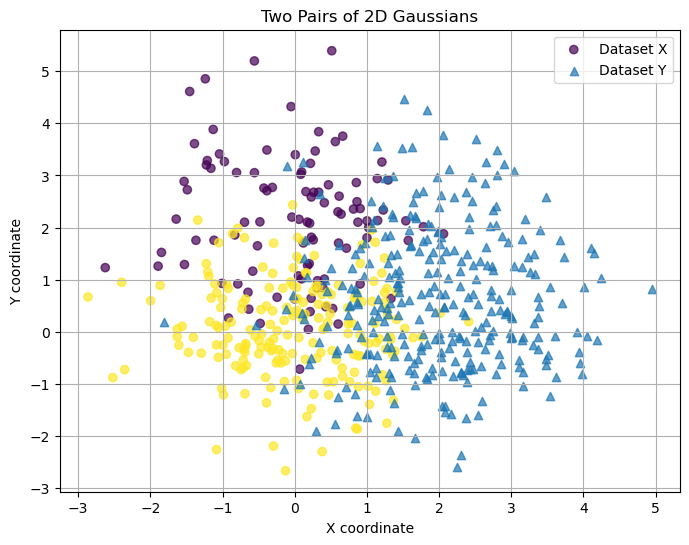

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


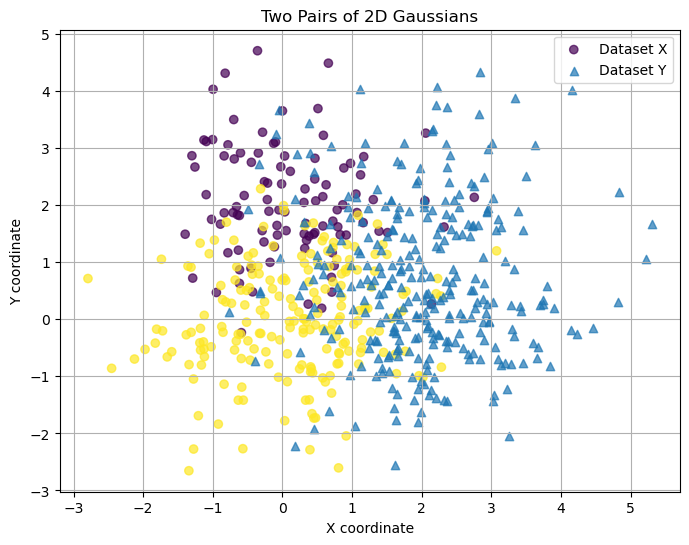

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


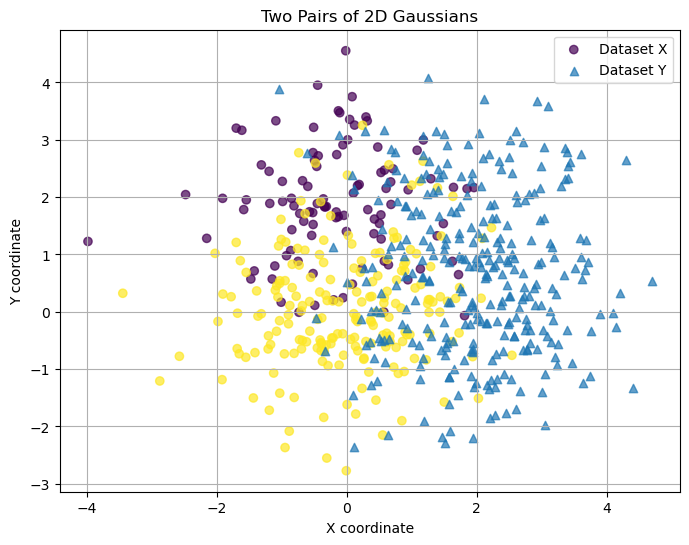

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


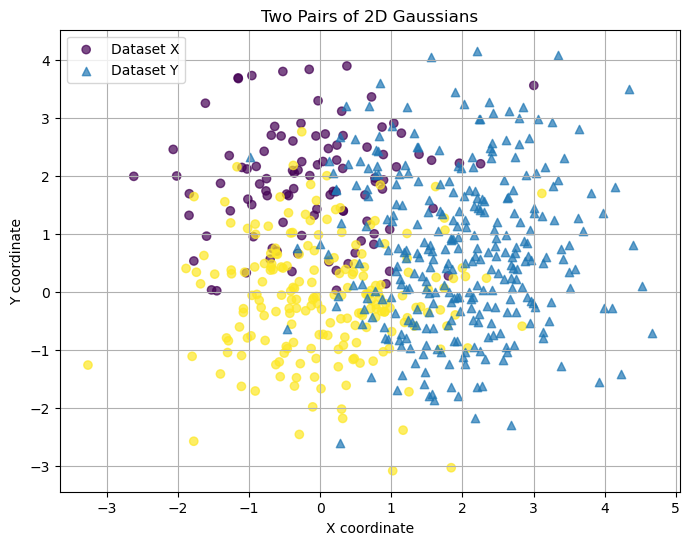

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


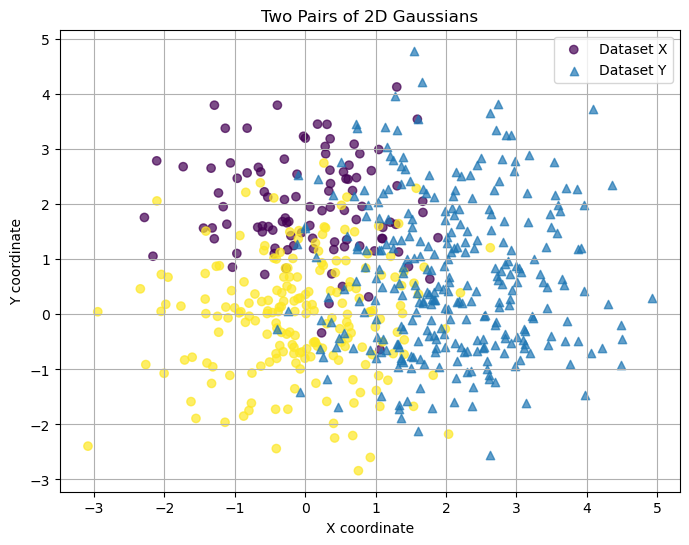

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


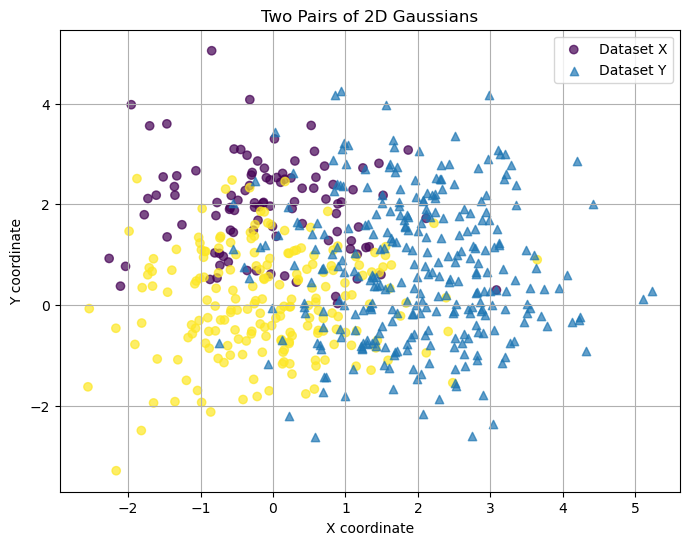

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


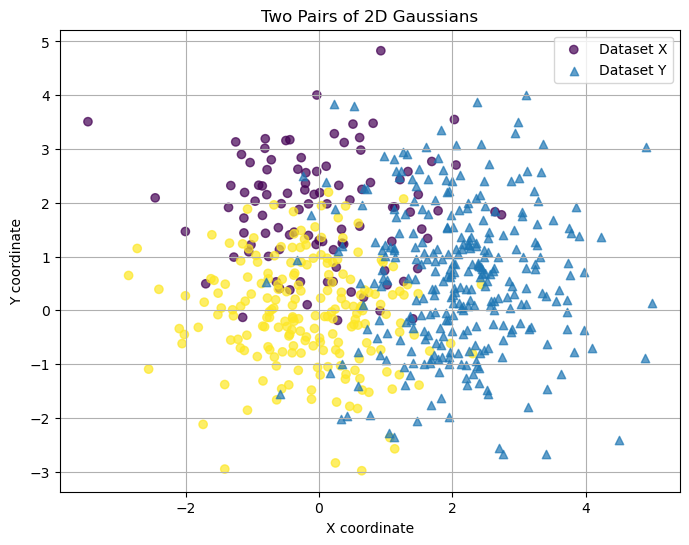

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


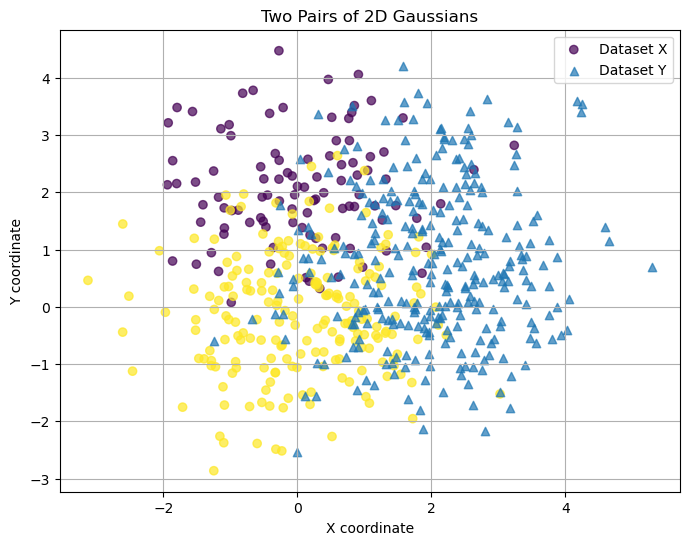

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


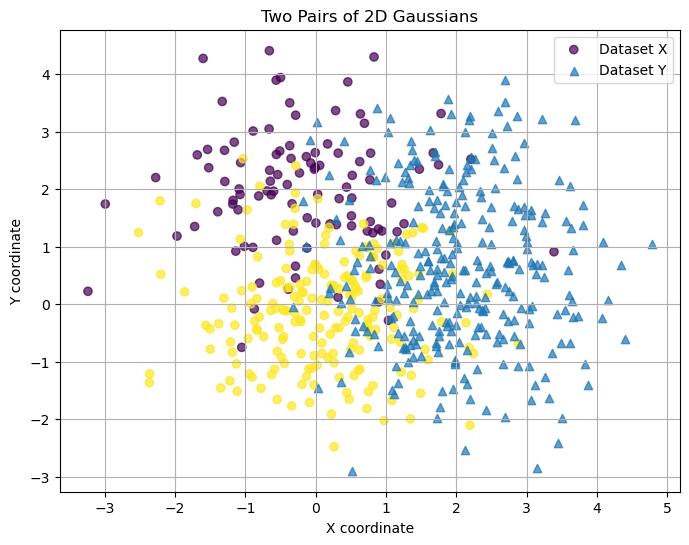

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


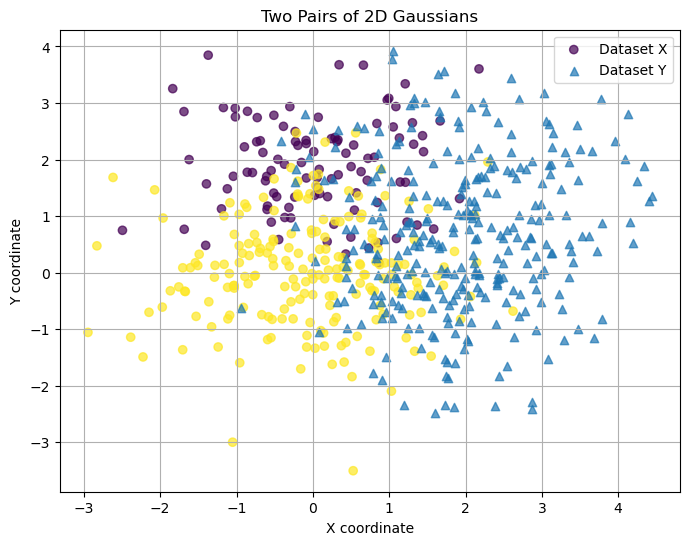

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Processing z = 3.0


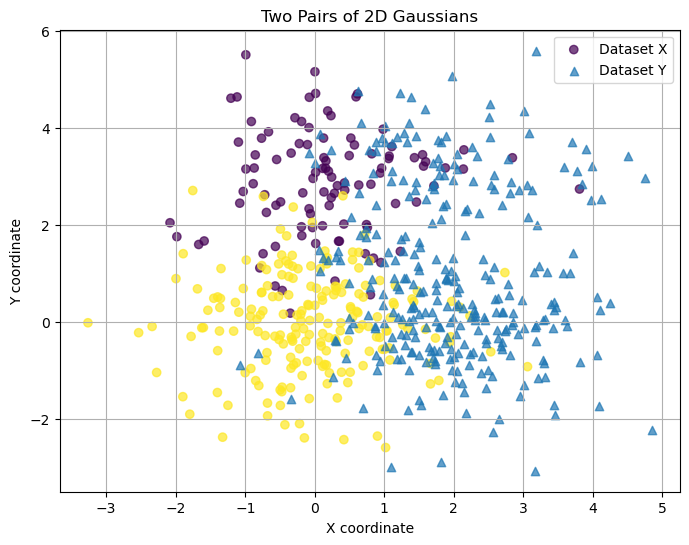

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


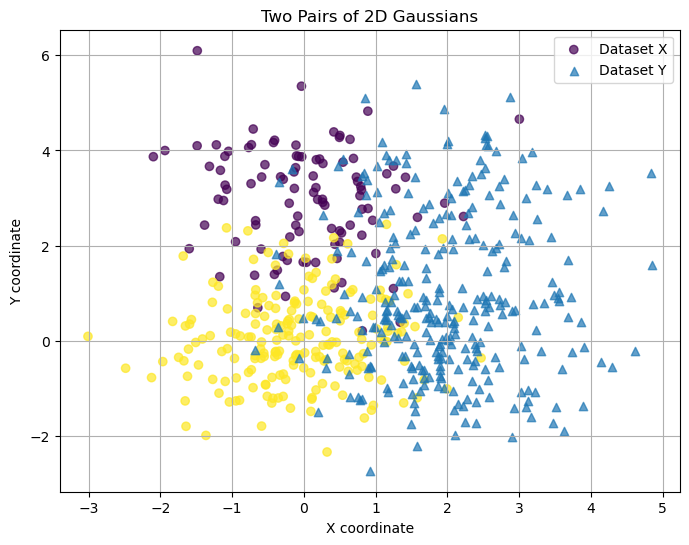

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


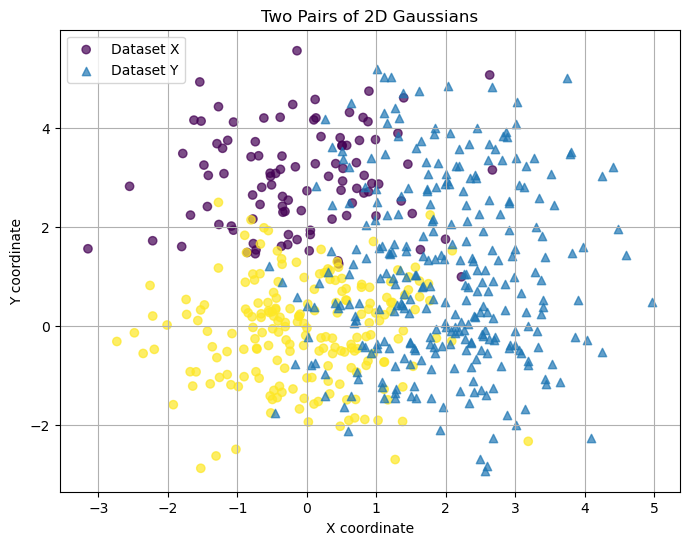

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


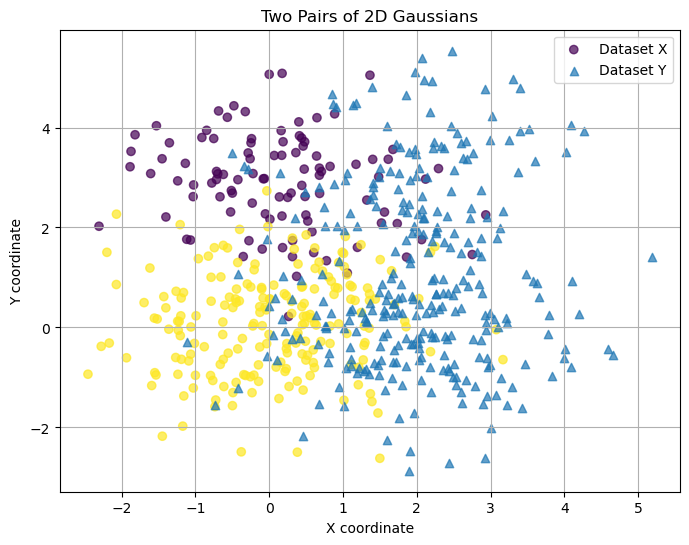

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


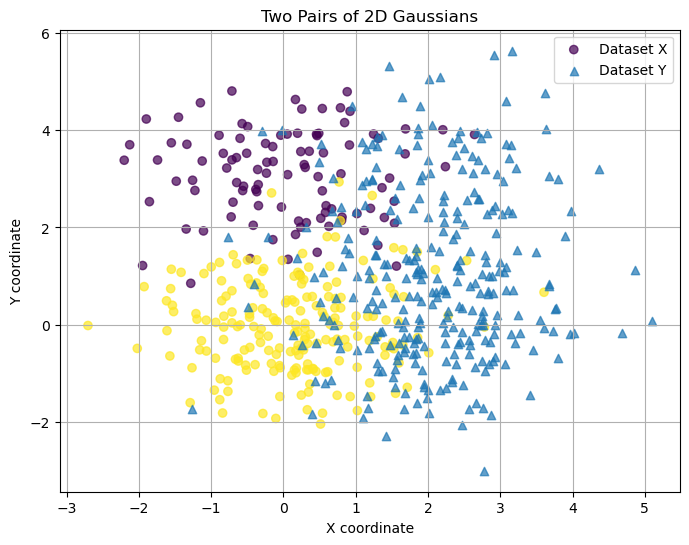

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


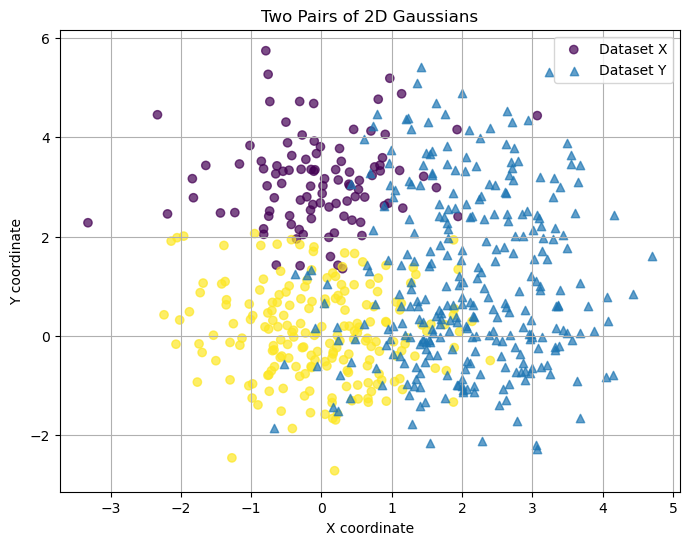

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


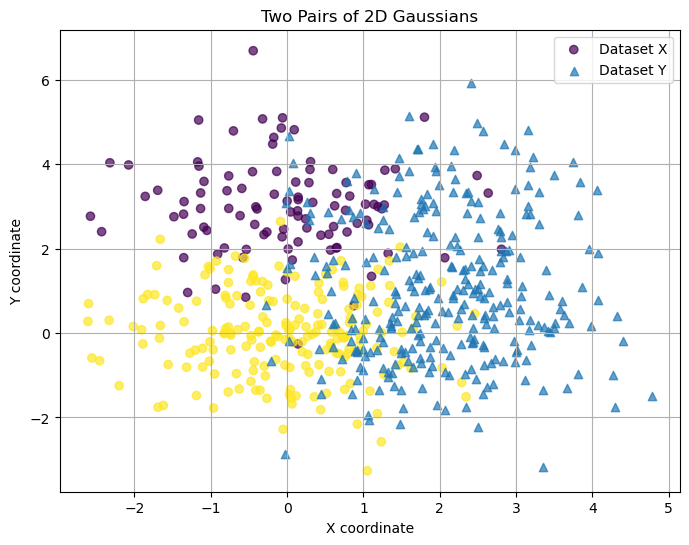

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


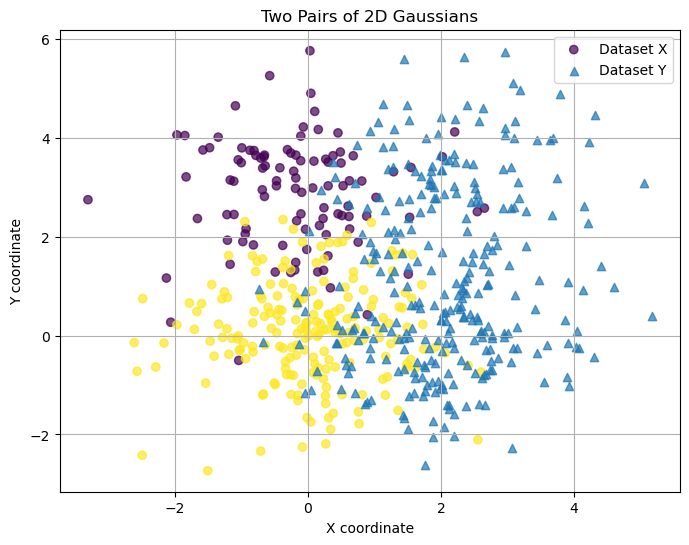

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


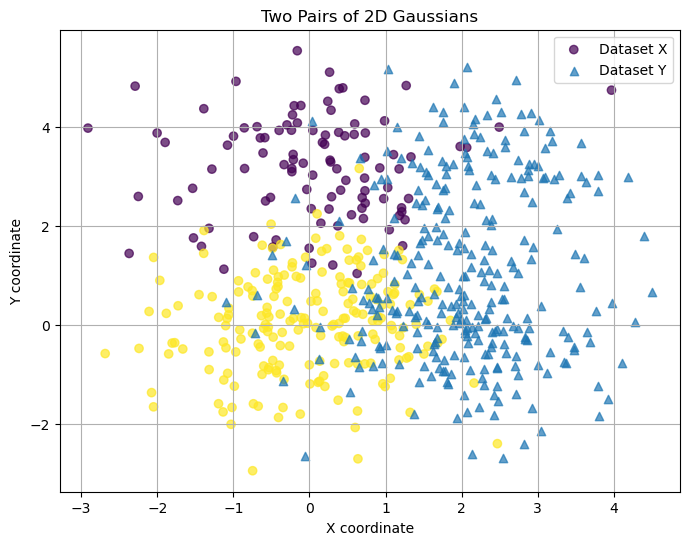

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


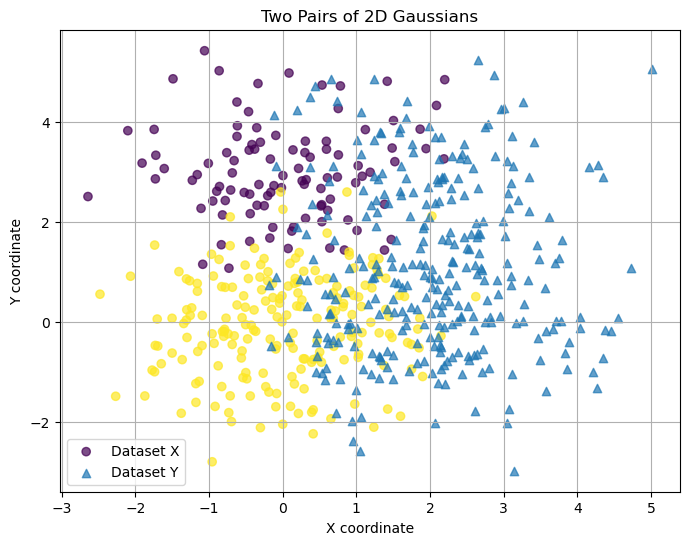

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Processing z = 4.0


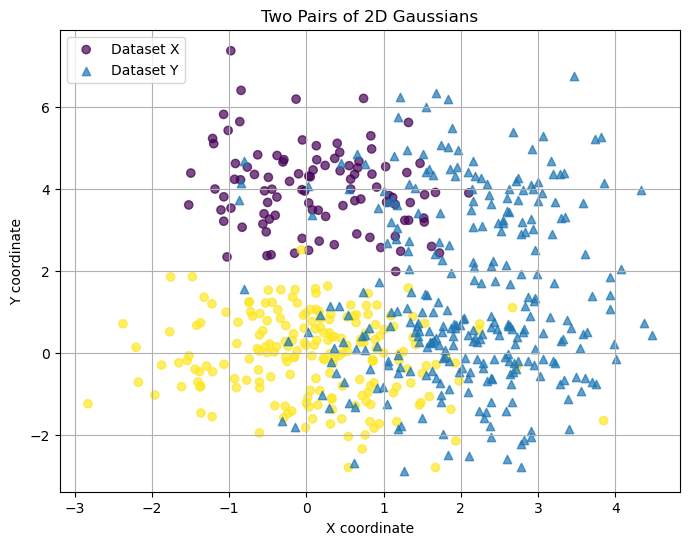

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


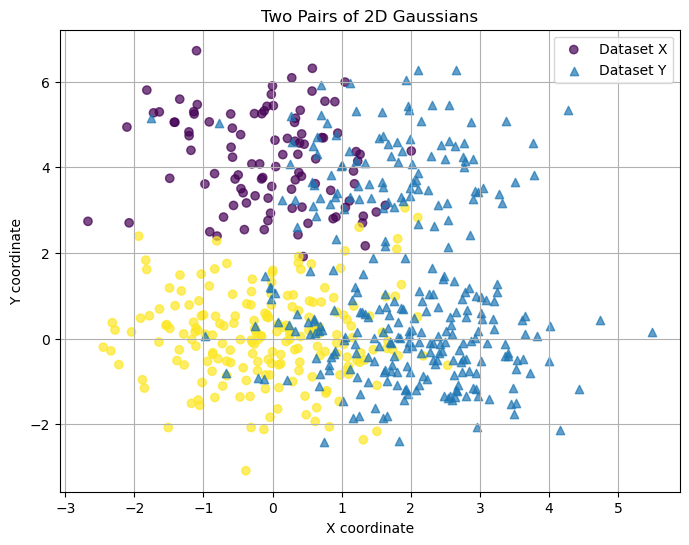

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


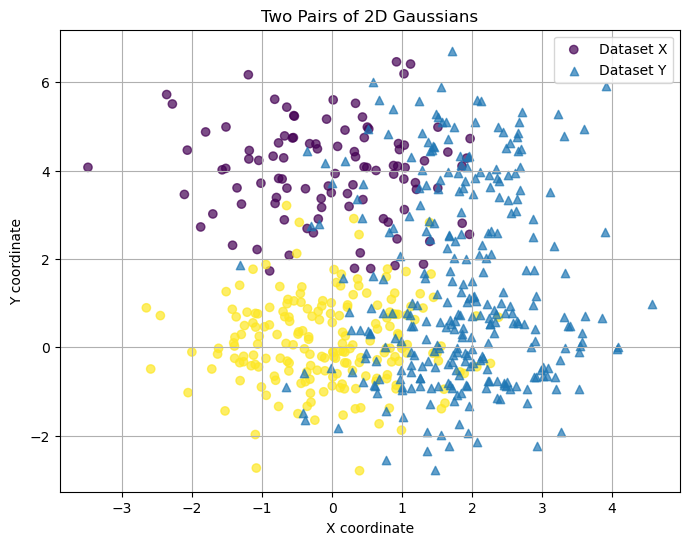

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


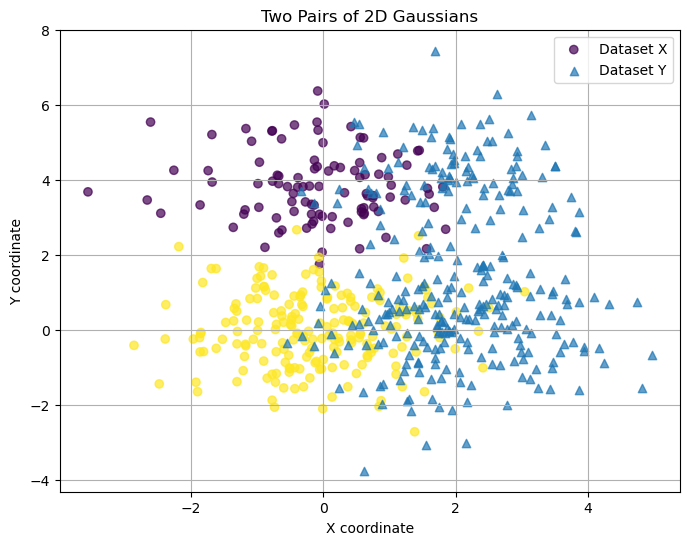

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


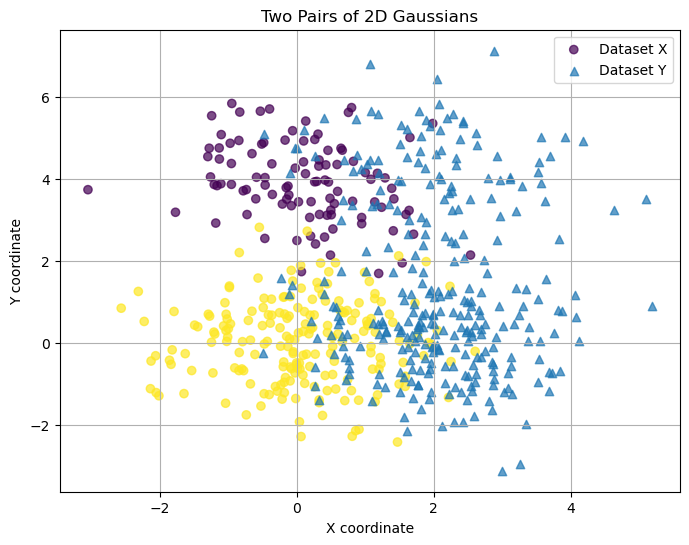

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


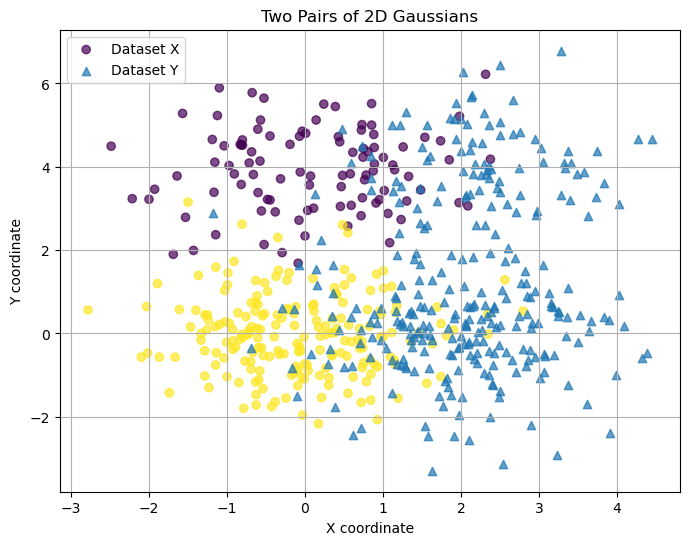

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


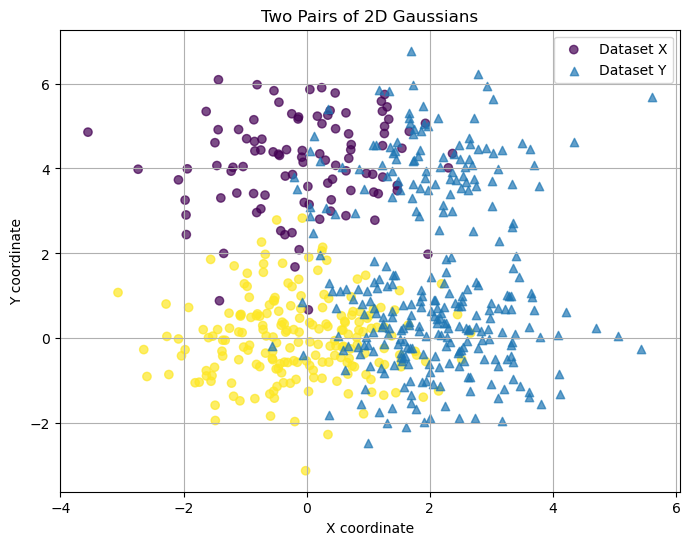

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


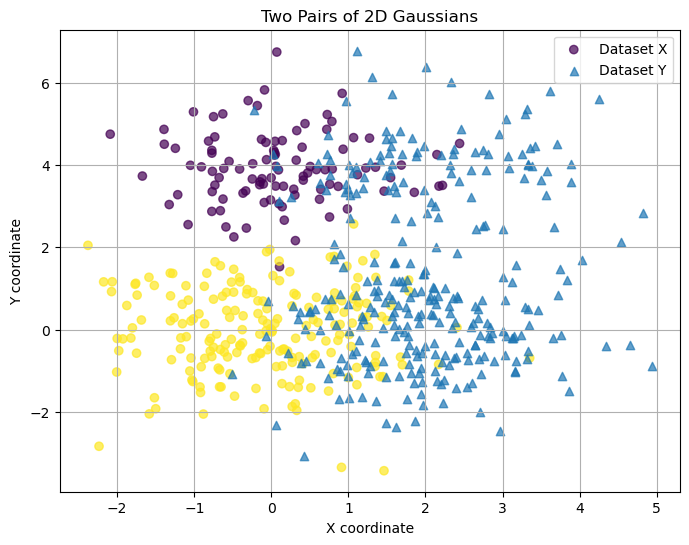

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


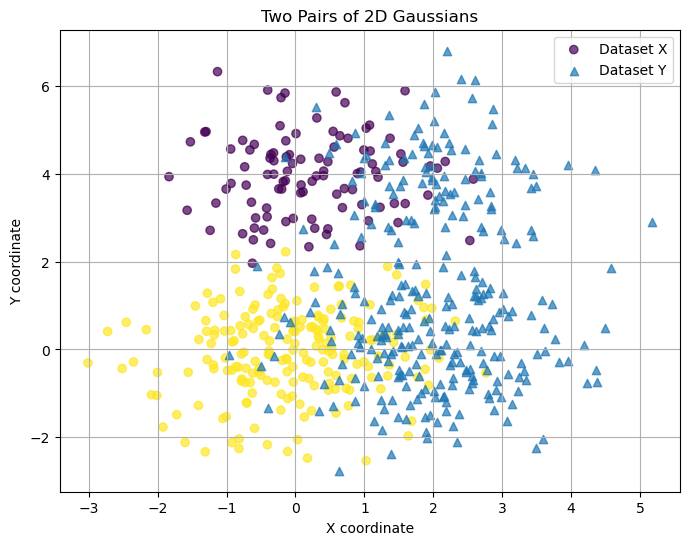

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


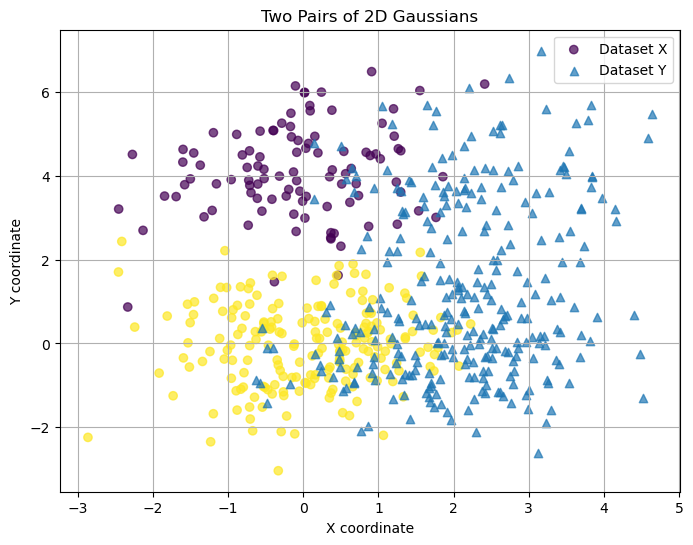

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Processing z = 5.0


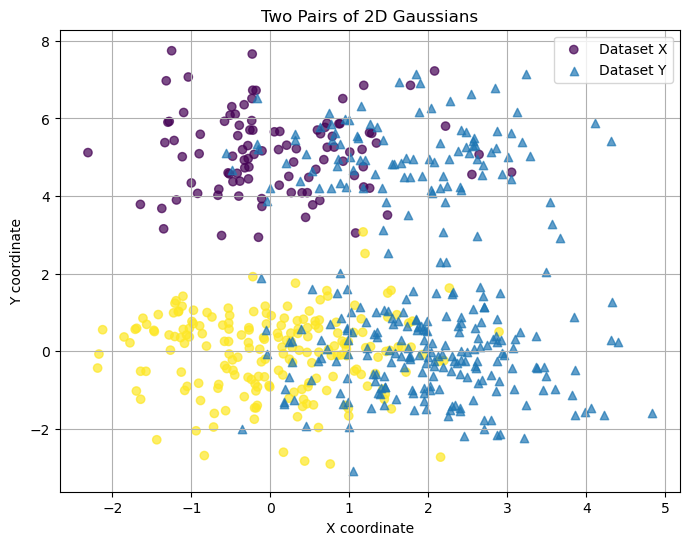

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


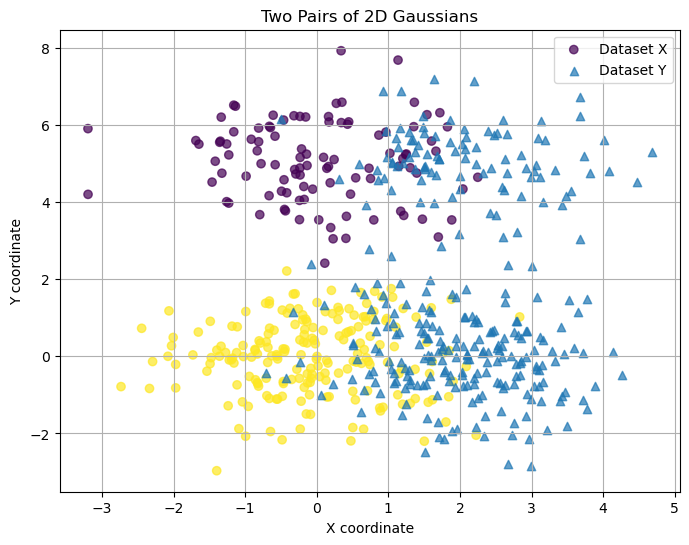

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


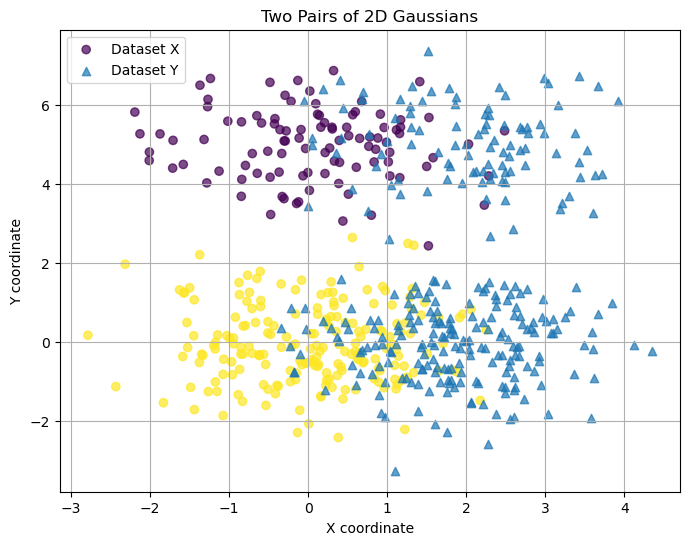

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


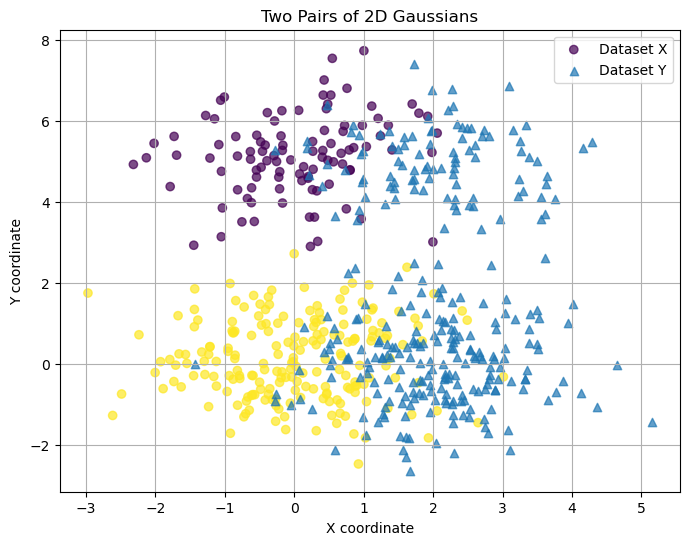

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


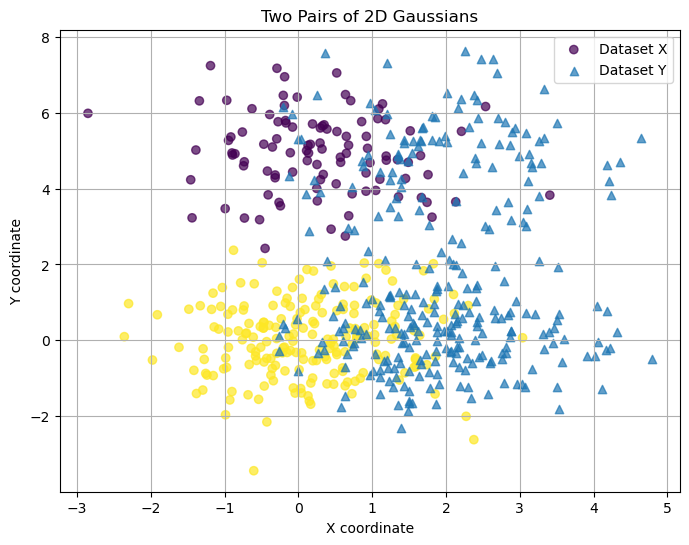

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


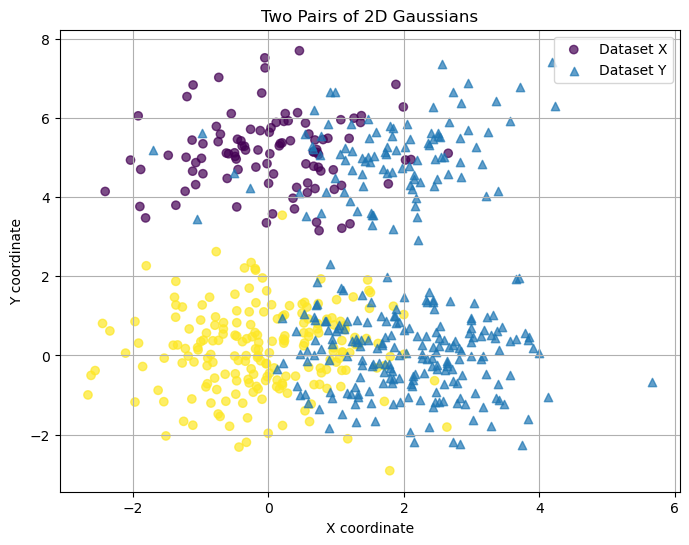

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


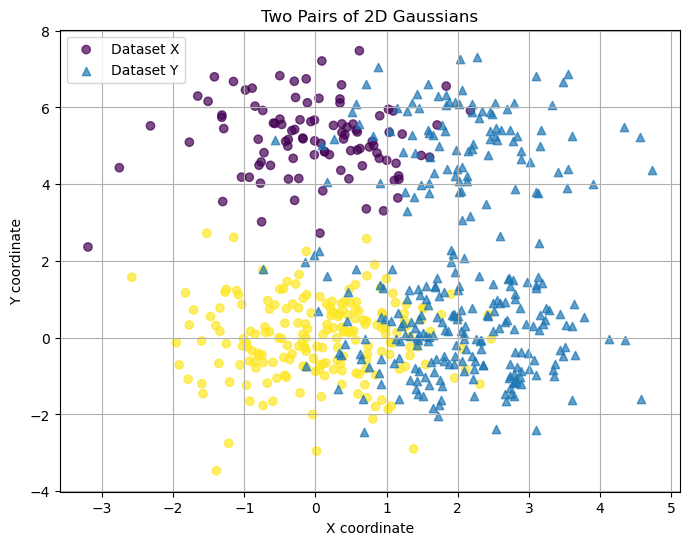

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


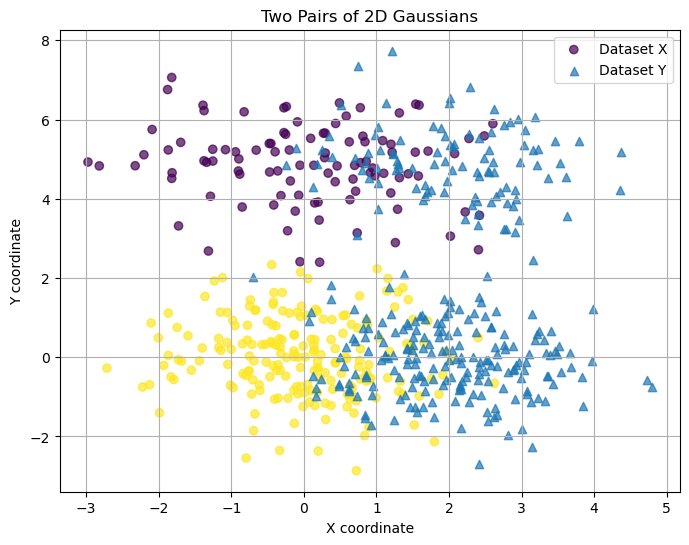

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


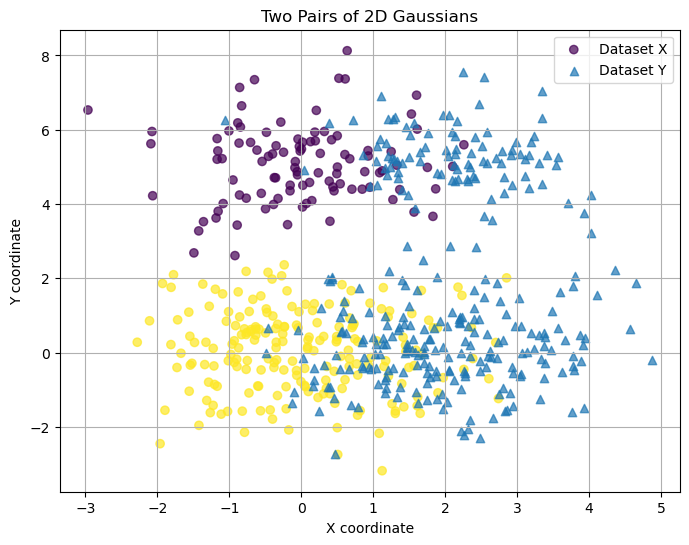

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


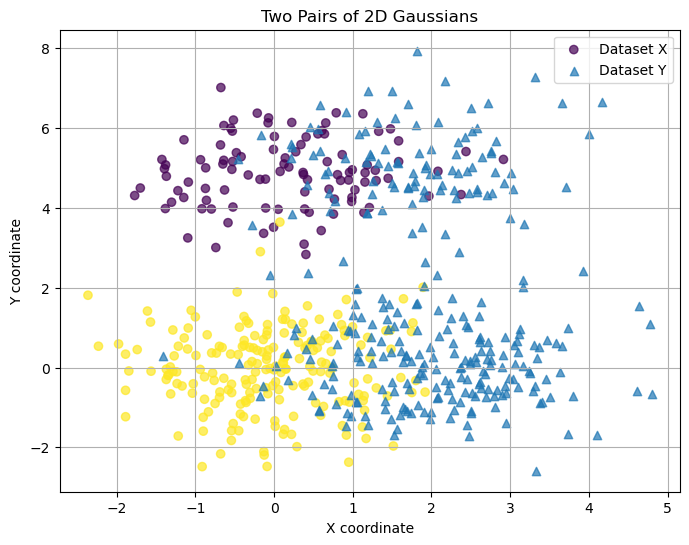

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Processing z = 6.0


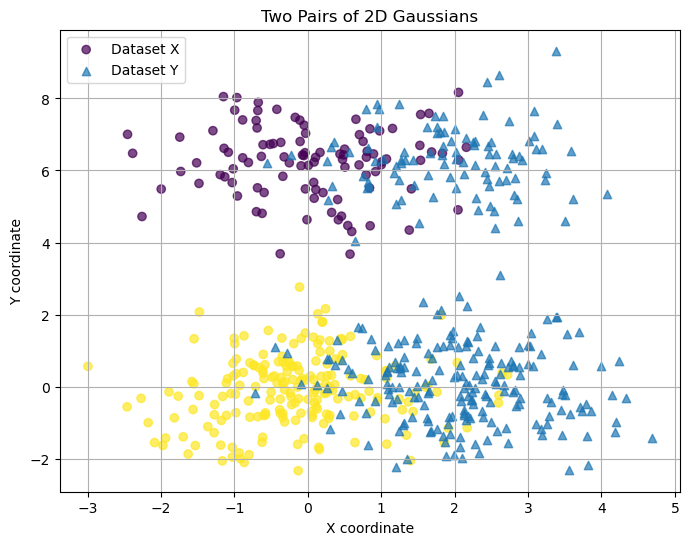

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


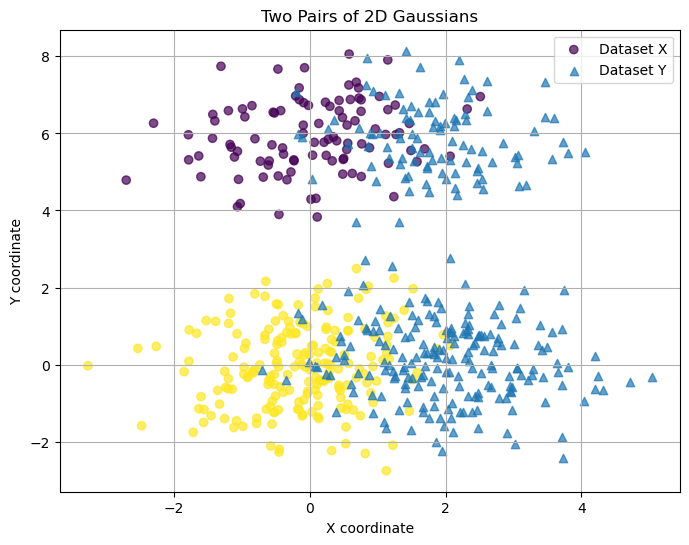

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


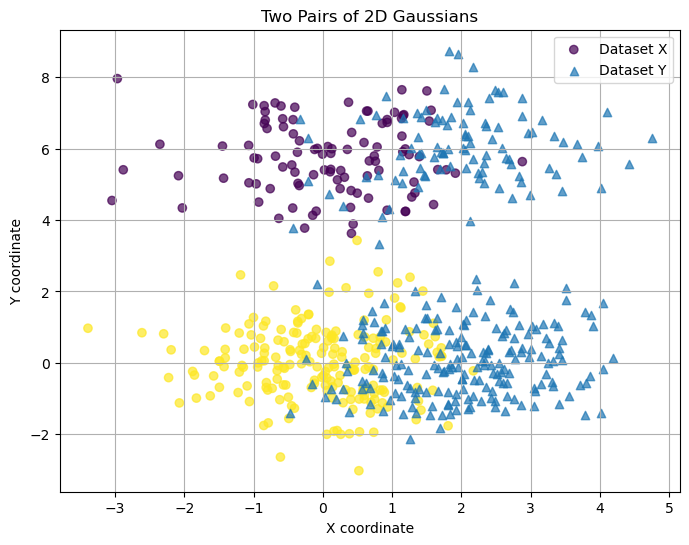

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


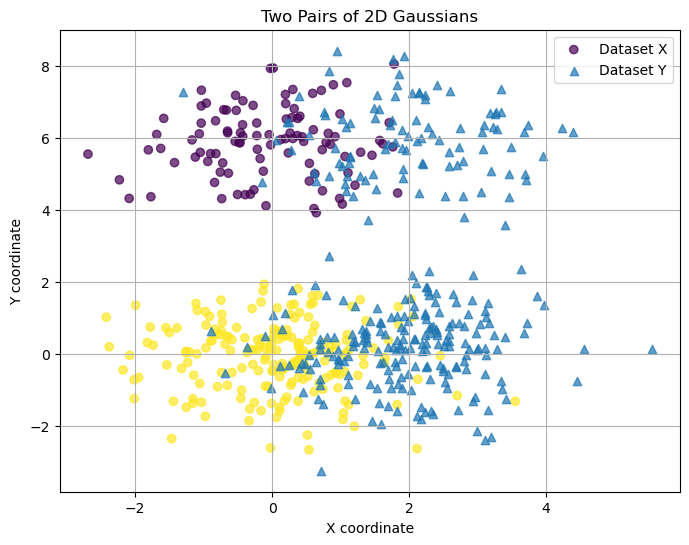

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


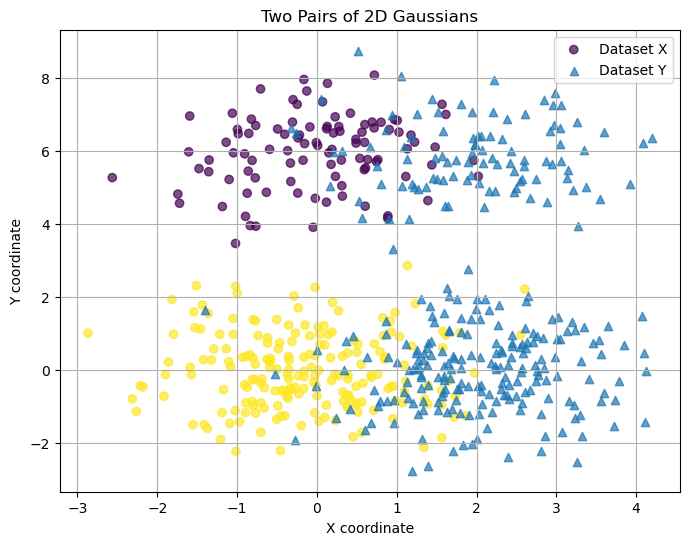

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


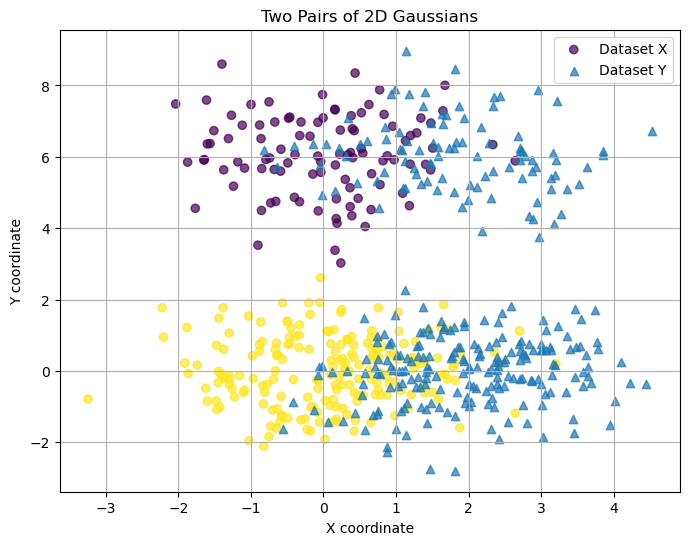

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


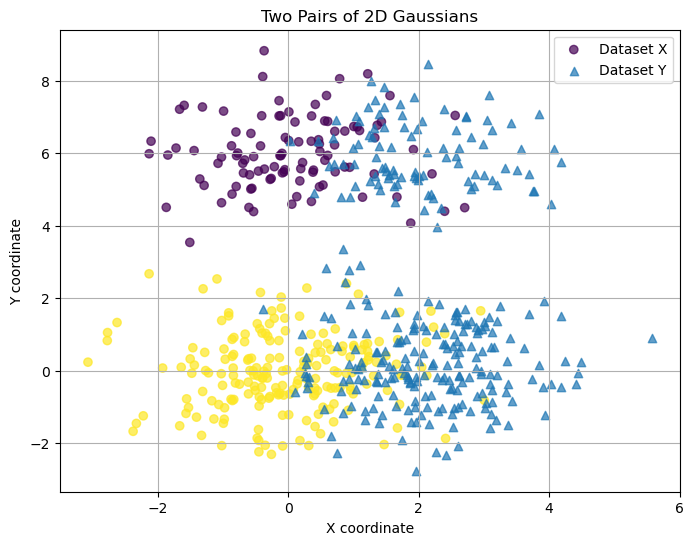

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


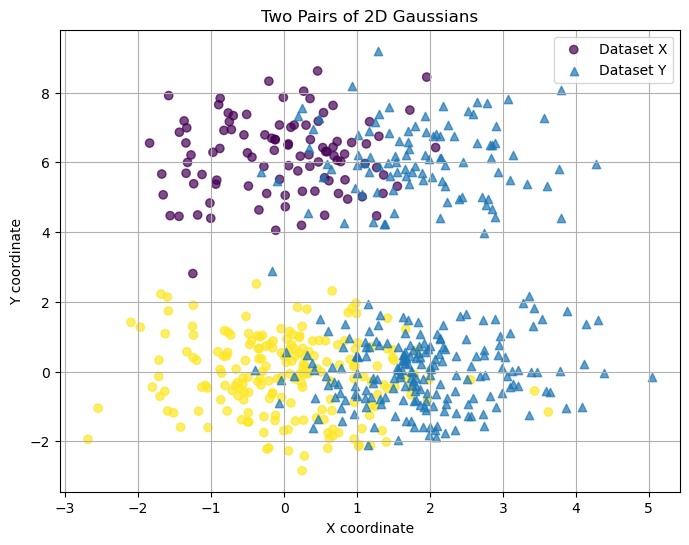

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


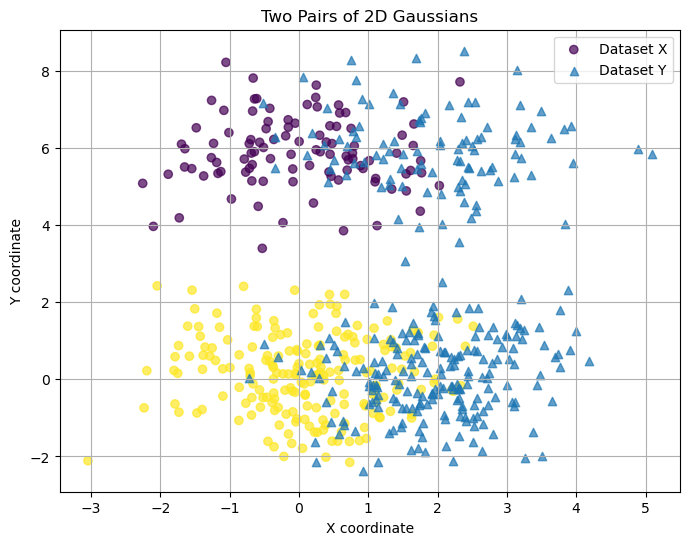

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


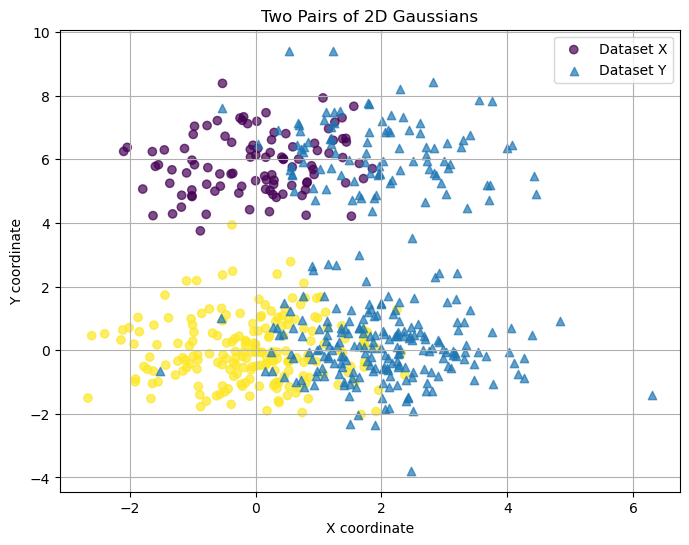

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


In [5]:


t = 2.0
n_top, n_bottom = 100, 200
cov1, cov2 = np.eye(2) , np.eye(2)

results = {'gmm': [], 'supervised_frlc': [], 'uniform_frlc': [], 'unsupervised_frlc': []}

K=10

zs=[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0]
tau_ins = [1e-3, 1e-2, 1e-1, 1.0, 10, 100]
best_taus = []

for z in zs:
    
        print(f'Processing z = {z}')
        mean_top, mean_bottom = np.array([0.0, z]), np.array([0.0, 0.0])
        shift = np.array([t, 0.0])
        
        gmm_ami, gmm_ari = [], []
        super_ami, super_ari = [], []
        unif_ami, unif_ari = [], []
        unsup_ami, unsup_ari = [], []
        
        for _ in range(K):
            
            X, Y, true_labels = generate_gaussian_mixture(n_top, n_bottom, mean_top, mean_bottom, cov1, cov2, shift)
            
            ami, ari = apply_gmm_clustering(X, true_labels)
            gmm_ami.append(ami)
            gmm_ari.append(ari)
            
            ami, ari = apply_frlc_clustering(X, Y, true_labels, device, \
                                             gQ=torch.tensor([1/3, 2/3]).float().to(device), gR=torch.tensor([1/3, 2/3]).float().to(device))
            super_ami.append(ami)
            super_ari.append(ari)
            
            ami, ari = apply_frlc_clustering(X, Y, true_labels, device)
            unif_ami.append(ami)
            unif_ari.append(ari)

            # Unsupervised + a minimal grid-search over tau_in
            best_ami = -1
            best_ari = -1
            best_tau = 0
            
            for tau in tau_ins:
                ami, ari = apply_frlc_clustering(X, Y, true_labels, device, tau_in=tau)
                if ami > best_ami:
                    best_ami = ami
                    best_ari = ari
                    best_tau = tau
            
            unsup_ami.append(best_ami)
            unsup_ari.append(best_ari)
            
            if _ == 0:
                best_taus.append(best_tau)
        
        results['gmm'].append((np.mean(gmm_ami), np.mean(gmm_ari)))
        results['supervised_frlc'].append((np.mean(super_ami), np.mean(super_ari)))
        results['uniform_frlc'].append((np.mean(unif_ami), np.mean(unif_ari)))
        results['unsupervised_frlc'].append((np.mean(unsup_ami), np.mean(unsup_ari)))


In [6]:
results

{'gmm': [(0.001197902240249874, 0.006249612520963337),
  (0.09692142682705582, 0.12535645663707567),
  (0.3389089547489194, 0.4418477980271752),
  (0.6244893583371444, 0.7435061006014949),
  (0.8406513876877633, 0.9130081293459227),
  (0.9538554337169529, 0.9784678617032144),
  (0.9906295895762918, 0.9959533085888228)],
 'supervised_frlc': [(-0.0008643129550216681, 0.00016059535296401376),
  (0.05504500907453632, 0.04477549423541717),
  (0.3394283299087513, 0.3825761746504958),
  (0.6469416195807024, 0.7673652402947025),
  (0.8490848110879649, 0.9183062215270983),
  (0.9639965035268787, 0.9838518917134301),
  (0.9906295895762918, 0.9959533085888228)],
 'uniform_frlc': [(0.000771256284918235, 0.0020105849567990755),
  (0.09755878329245257, 0.11026684538064331),
  (0.3068904481060513, 0.3203949502730517),
  (0.4552907191166672, 0.43769021943528774),
  (0.49034749935258387, 0.4635496438212437),
  (0.49558518150707587, 0.47183058091573704),
  (0.498434932504523, 0.4763764206939475)],
 'uns

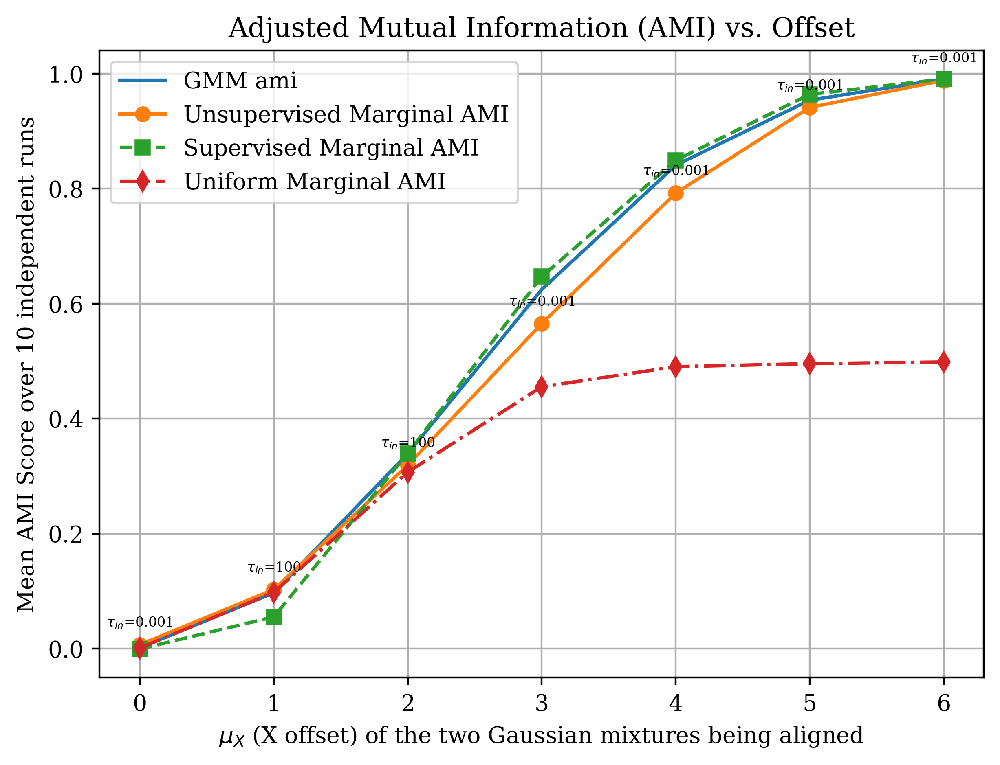

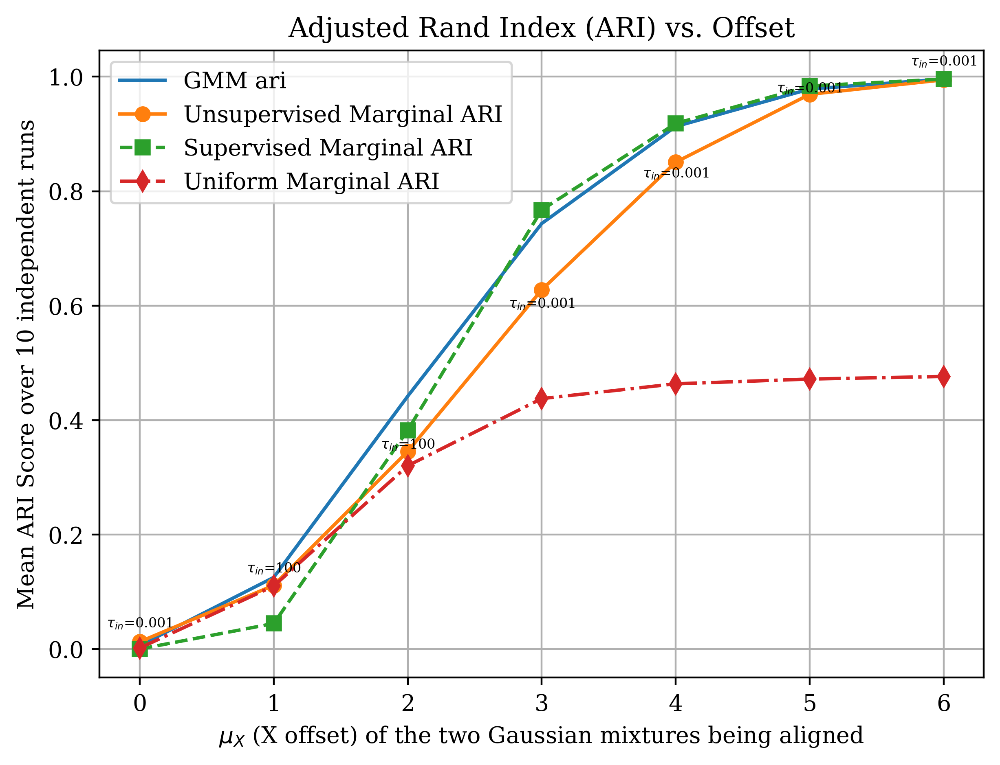

In [7]:
import matplotlib as mpl
mpl.rcParams['text.usetex'] = False
mpl.rcParams['font.family'] = 'serif'

# Improved Plot for AMI
plt.figure(figsize=(7, 5), dpi=400)
plt.plot(zs, np.array(results['gmm'])[:,0], label='GMM ami')
plt.plot(zs, np.array(results['unsupervised_frlc'])[:,0], marker='o', linestyle='-', label='Unsupervised Marginal AMI')
plt.plot(zs, np.array(results['supervised_frlc'])[:,0], marker='s', linestyle='--', label='Supervised Marginal AMI')
plt.plot(zs, np.array(results['uniform_frlc'])[:,0], marker='d', linestyle='-.', label='Uniform Marginal AMI')

# Annotate best hyperparameters
for i, txt in enumerate(best_taus):
    plt.annotate(r"$\tau_{in}$="+f"{txt}", (zs[i], np.array(results['unsupervised_frlc'])[i, 0]), 
                 textcoords="offset points", xytext=(0, 8), ha='center', fontsize=6, color='black')

plt.xlabel(r"$\mu_{X}$ (X offset) of the two Gaussian mixtures being aligned")
plt.ylabel(f'Mean AMI Score over {K} independent runs')
plt.title("Adjusted Mutual Information (AMI) vs. Offset")
plt.legend()
plt.grid(True)
plt.savefig("AMI_GaussMix.pdf", bbox_inches='tight')
plt.show()

# Improved Plot for ARI
plt.figure(figsize=(7, 5), dpi=400)

plt.plot(zs, np.array(results['gmm'])[:,1], label='GMM ari')
plt.plot(zs, np.array(results['unsupervised_frlc'])[:,1], marker='o', linestyle='-', label='Unsupervised Marginal ARI')
plt.plot(zs, np.array(results['supervised_frlc'])[:,1], marker='s', linestyle='--', label='Supervised Marginal ARI')
plt.plot(zs, np.array(results['uniform_frlc'])[:,1], marker='d', linestyle='-.', label='Uniform Marginal ARI')

# Annotate best hyperparameters
for i, txt in enumerate(best_taus):
    plt.annotate(r"$\tau_{in}$="+f"{txt}", (zs[i], np.array(results['unsupervised_frlc'])[i, 0]), 
                 textcoords="offset points", xytext=(0, 8), ha='center', fontsize=6, color='black')


plt.xlabel(r"$\mu_{X}$ (X offset) of the two Gaussian mixtures being aligned")
plt.ylabel(f'Mean ARI Score over {K} independent runs')
plt.title("Adjusted Rand Index (ARI) vs. Offset")
plt.legend()
plt.grid(True)
plt.savefig("ARI_GaussMix.pdf", bbox_inches='tight')
plt.show()

Points in dataset 1: 500, in dataset 2: 500


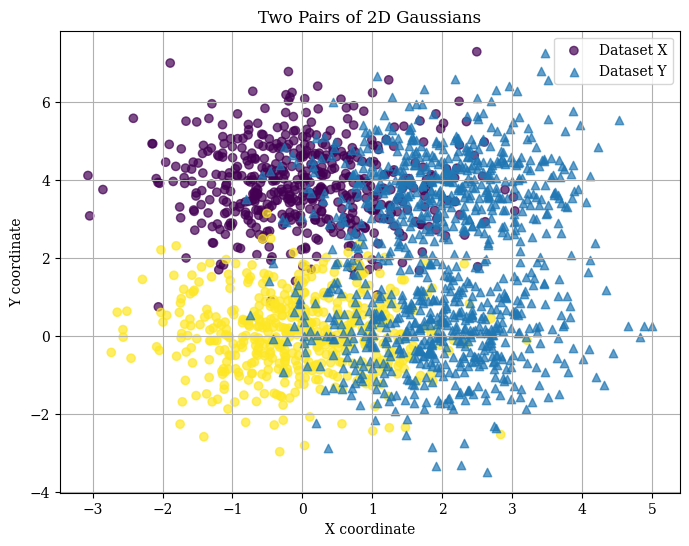

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


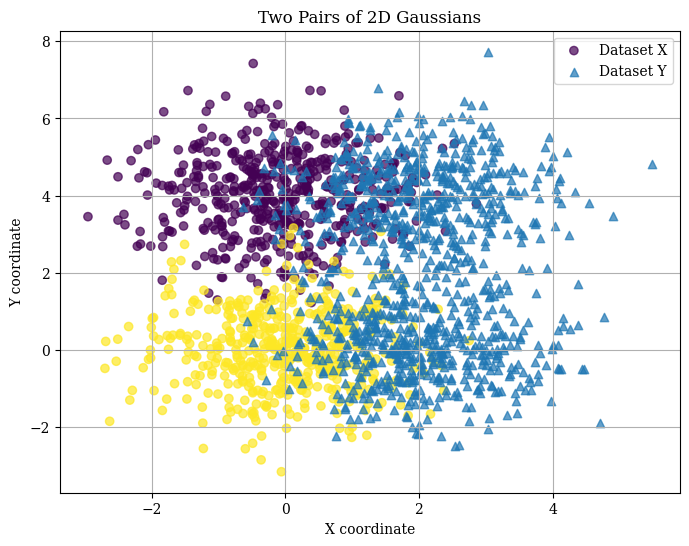

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


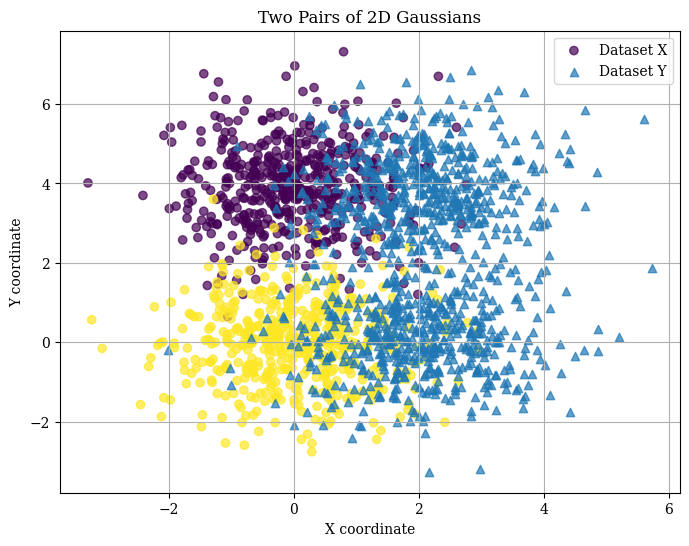

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


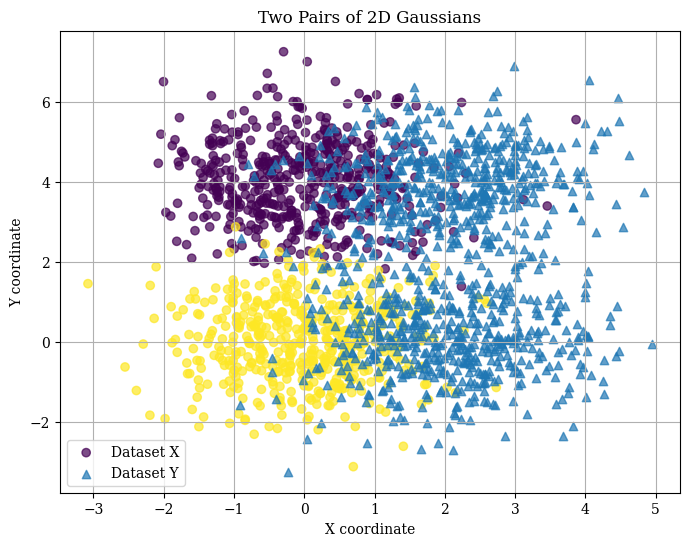

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


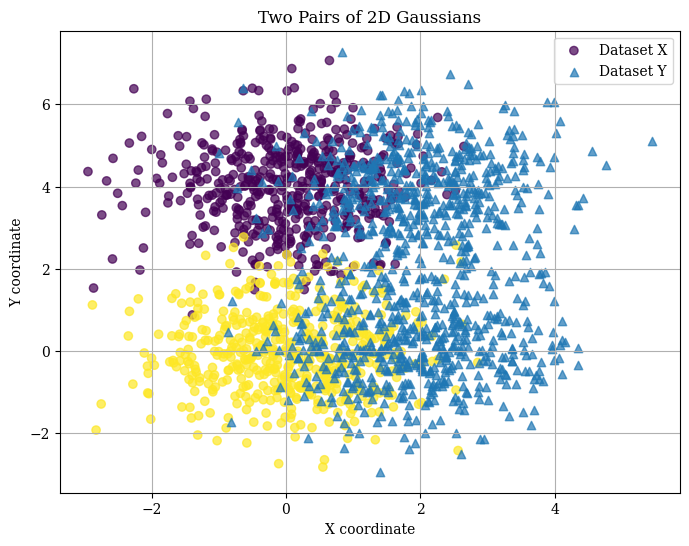

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


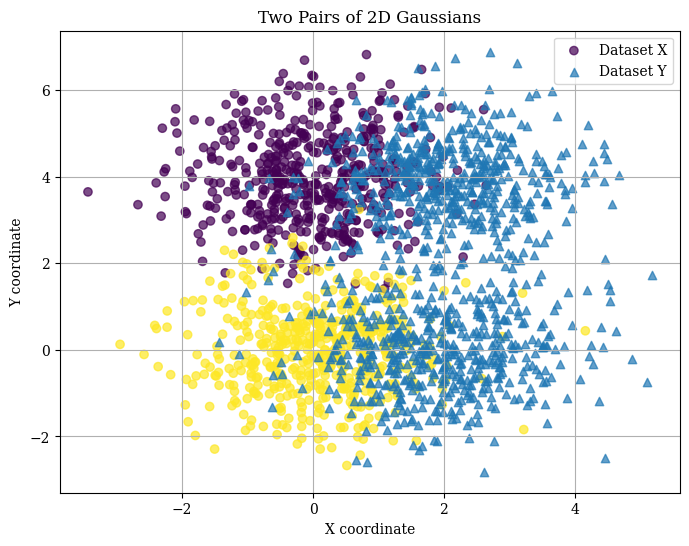

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


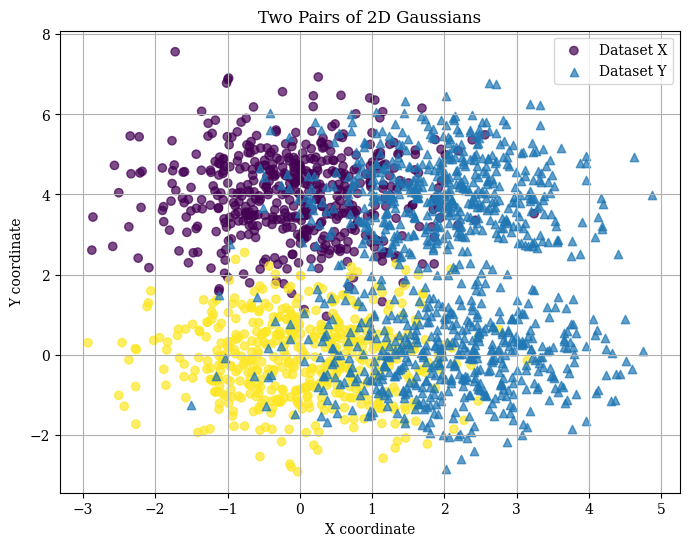

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


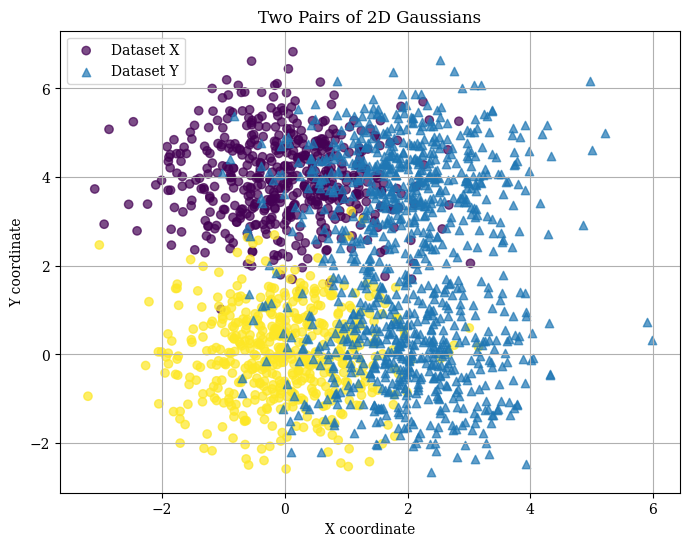

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


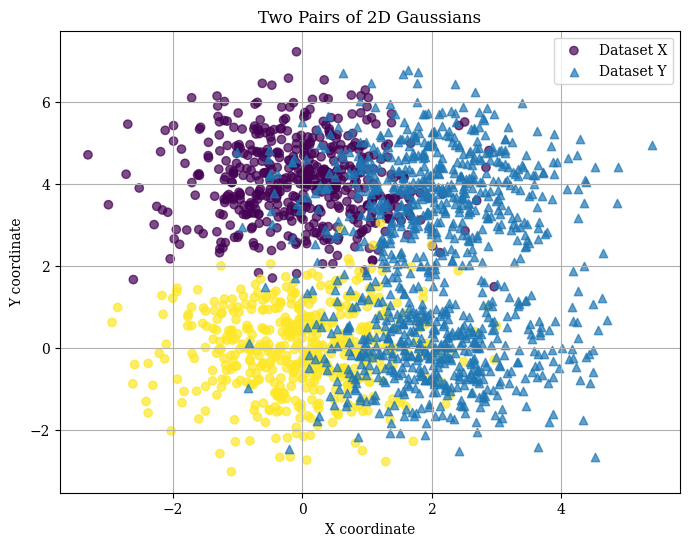

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


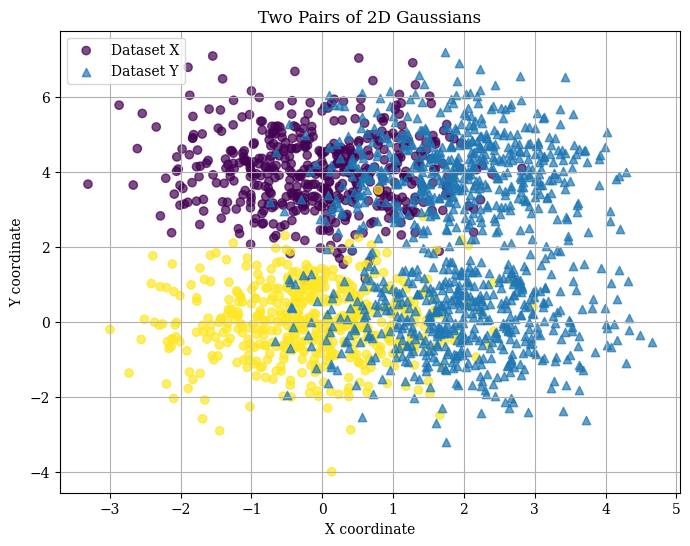

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Points in dataset 1: 550, in dataset 2: 450


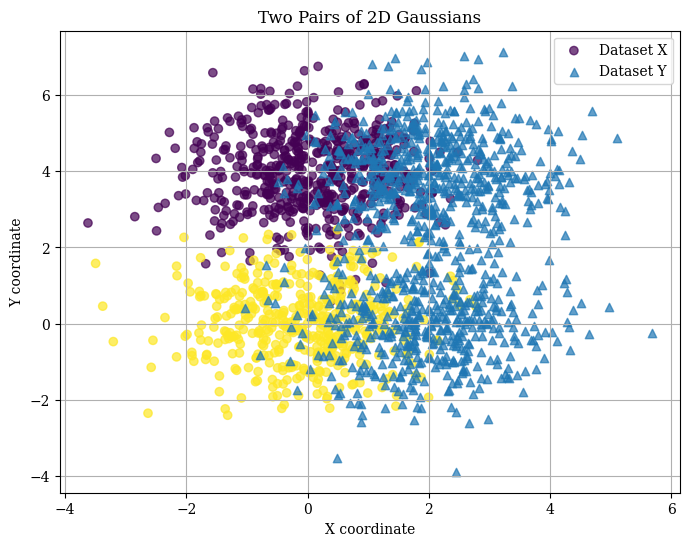

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


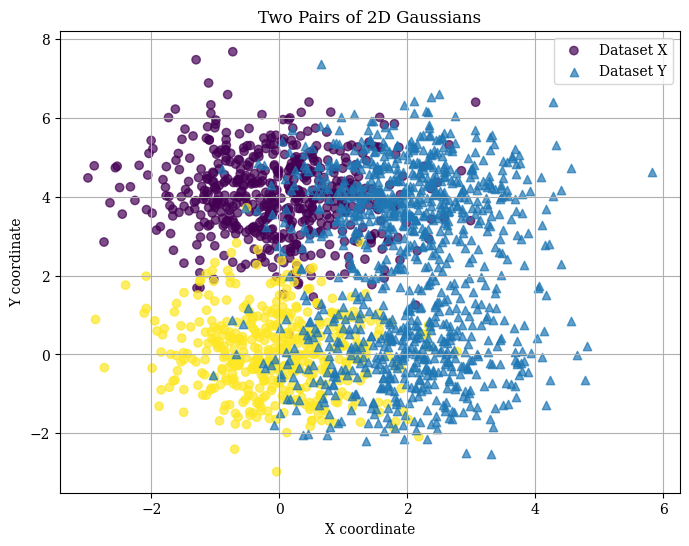

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


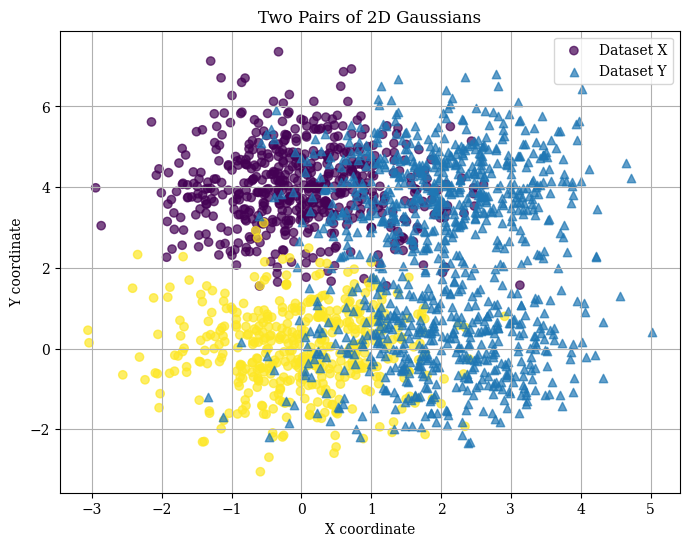

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


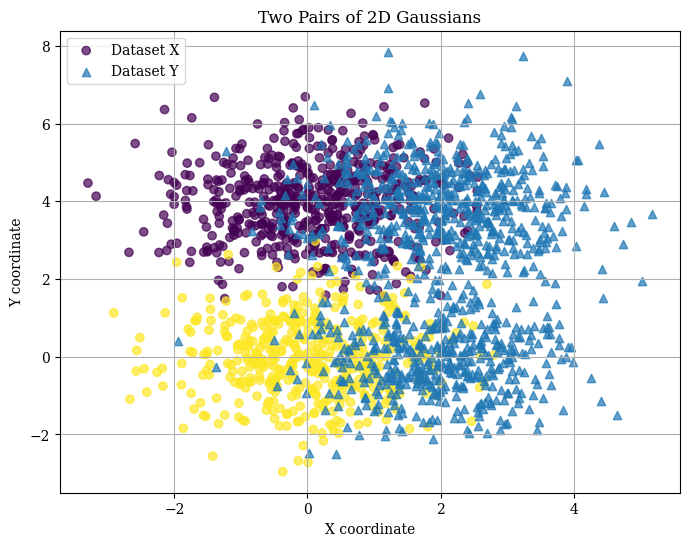

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


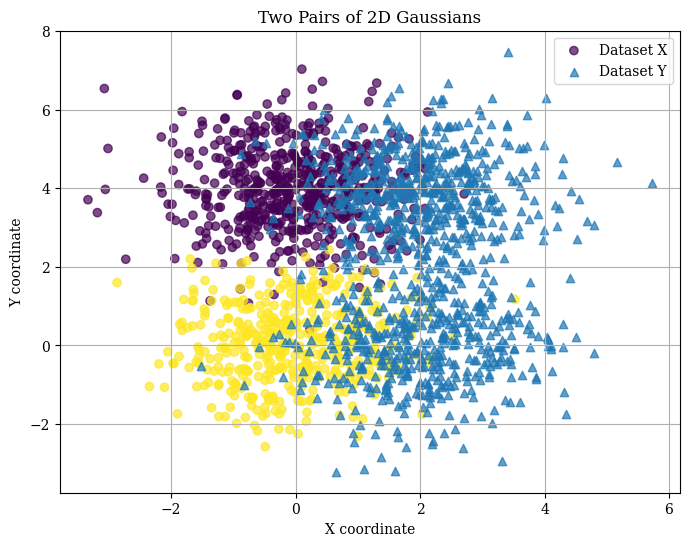

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


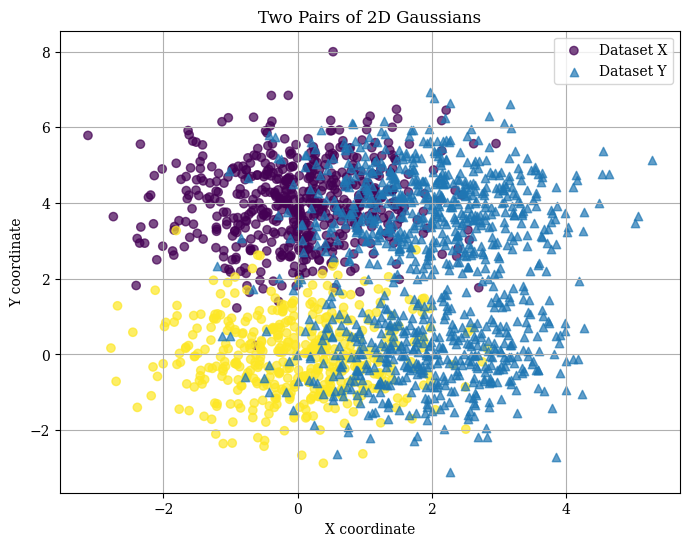

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


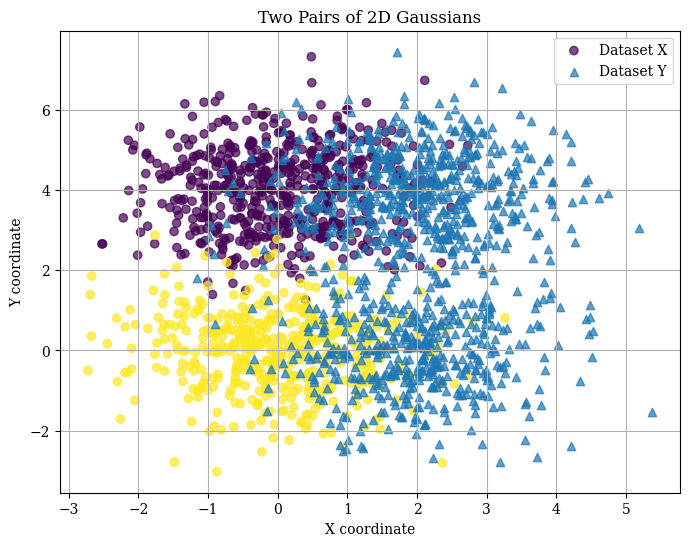

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


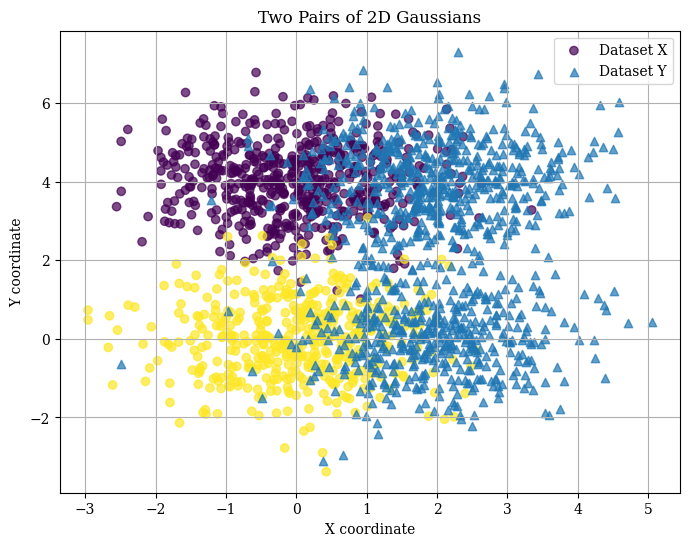

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


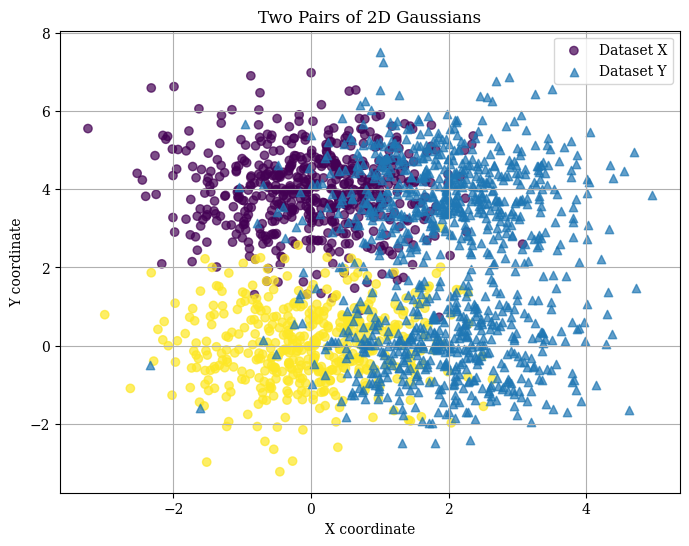

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


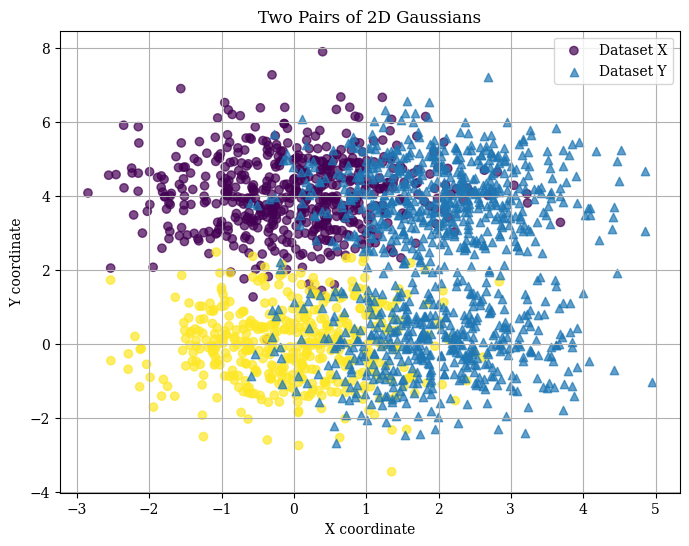

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Points in dataset 1: 600, in dataset 2: 400


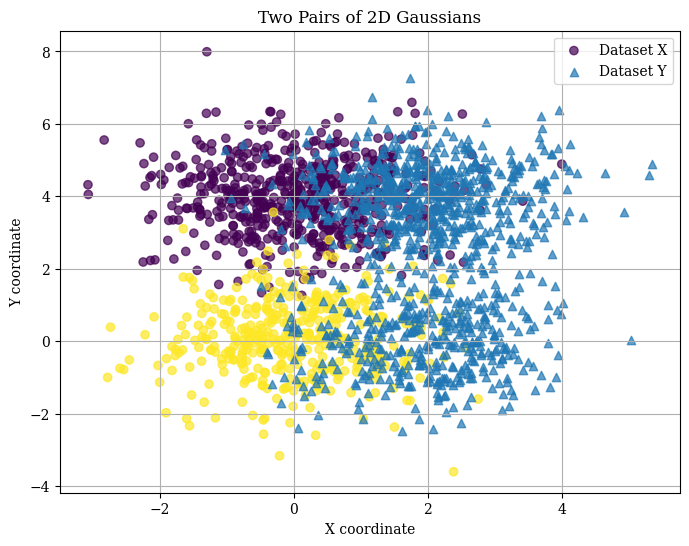

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


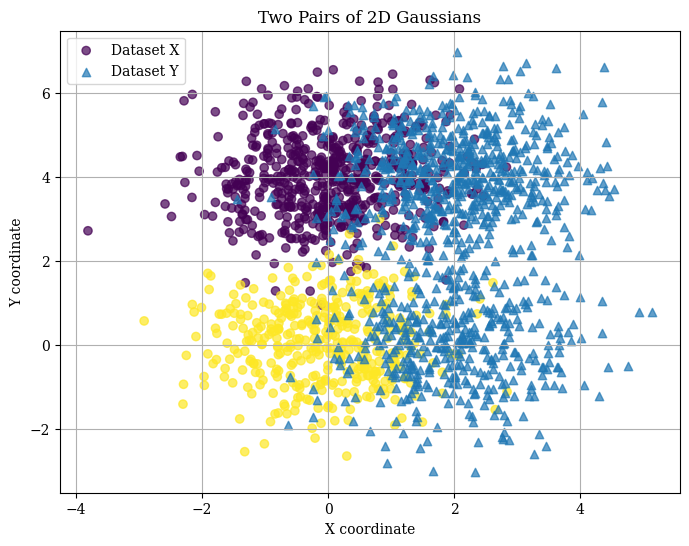

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


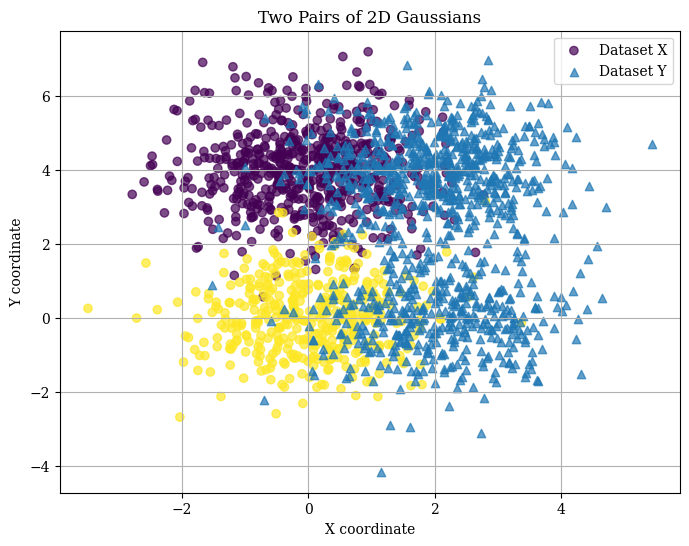

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


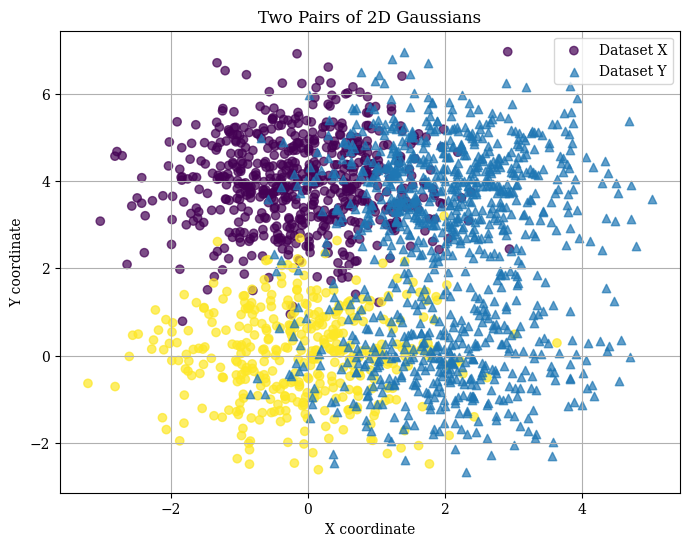

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


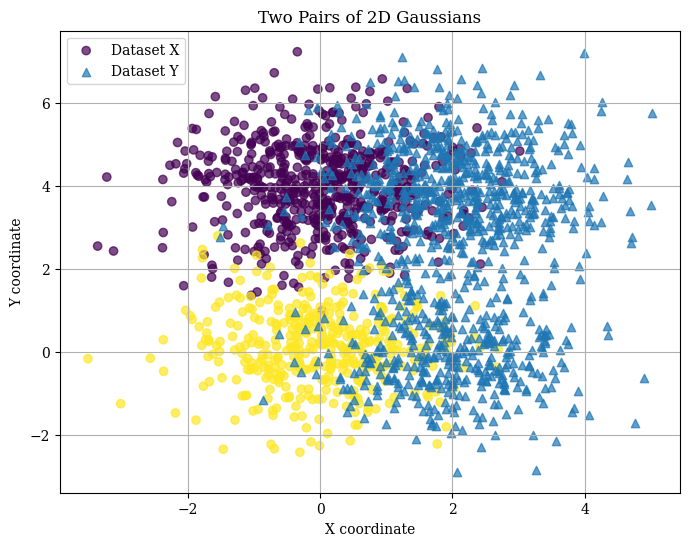

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


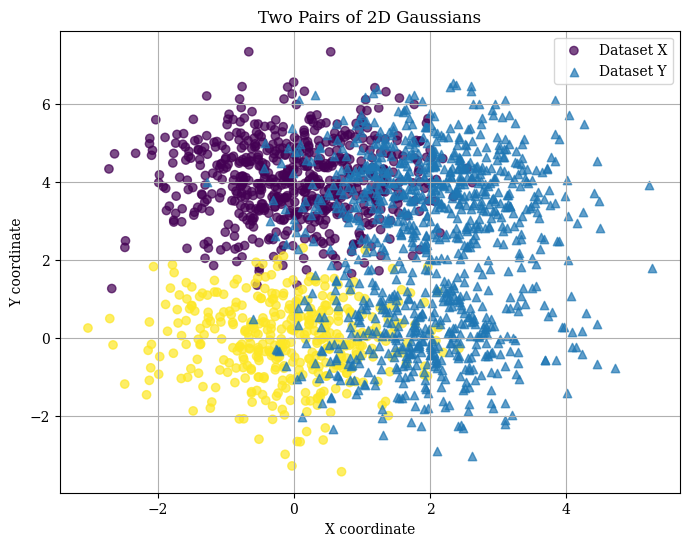

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


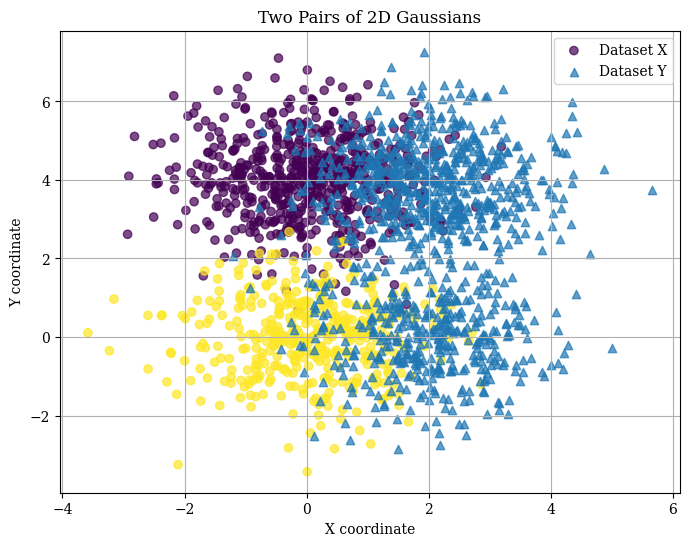

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


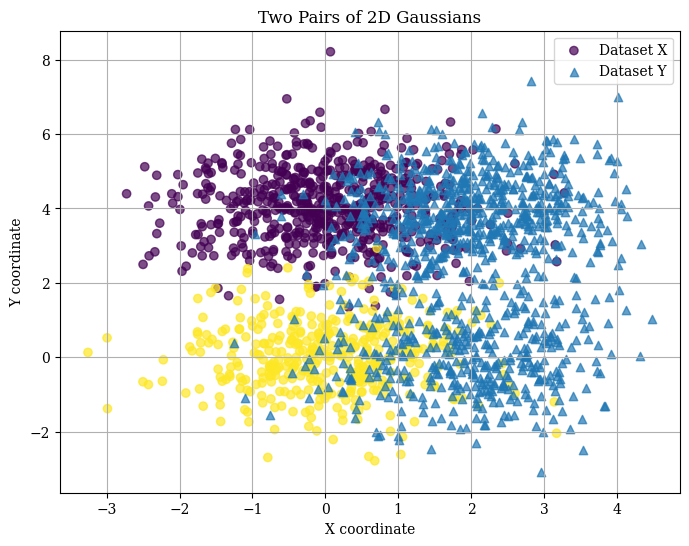

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


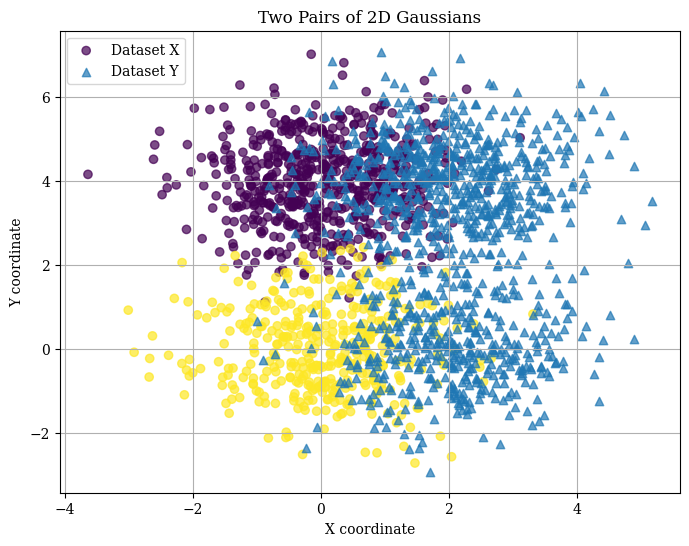

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


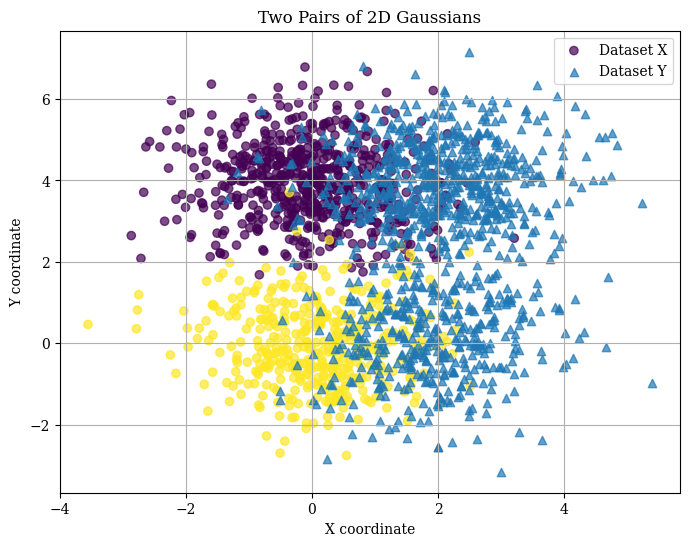

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Points in dataset 1: 650, in dataset 2: 350


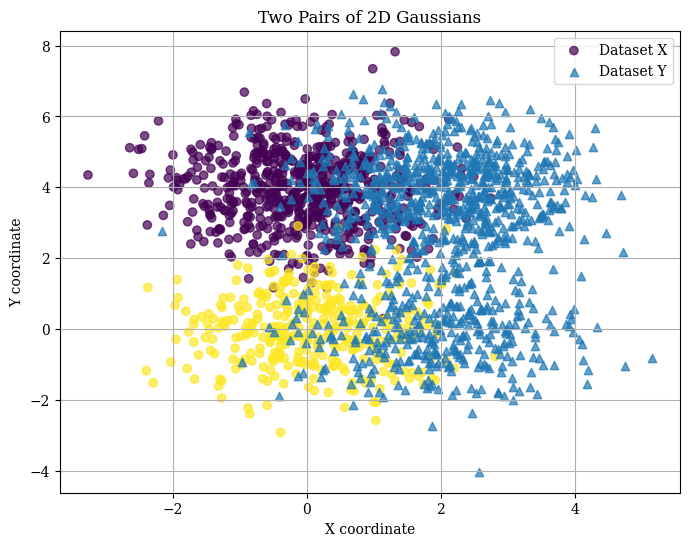

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


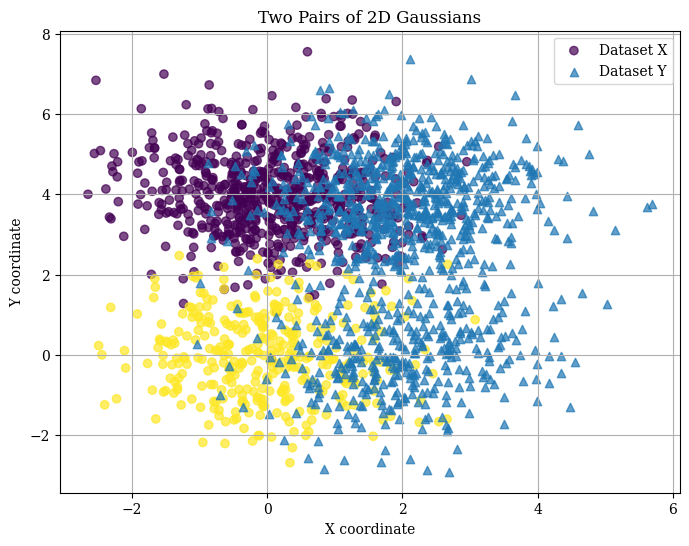

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


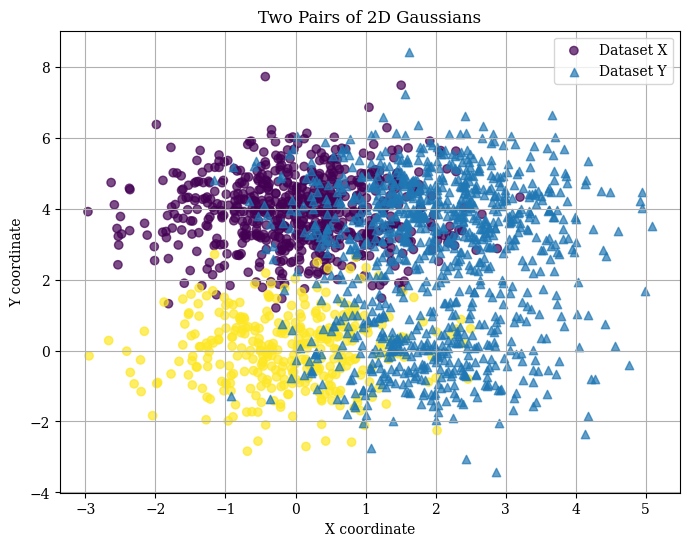

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


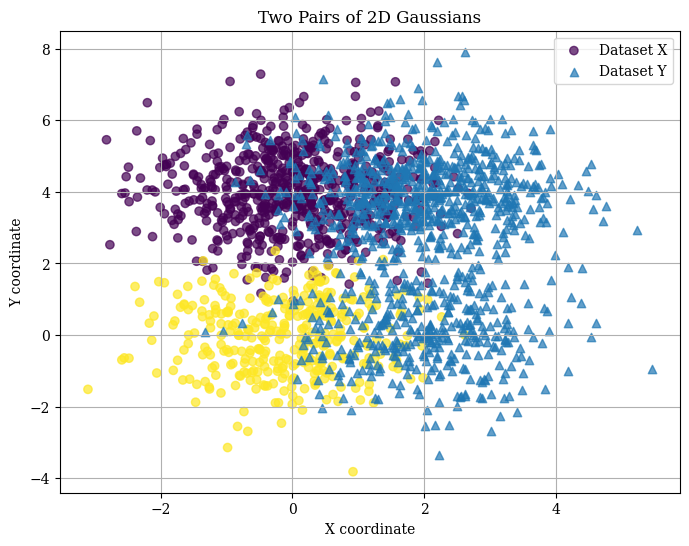

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


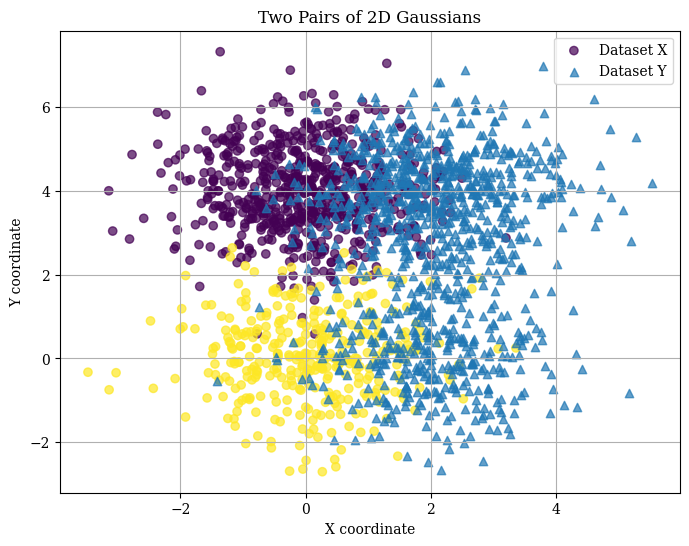

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


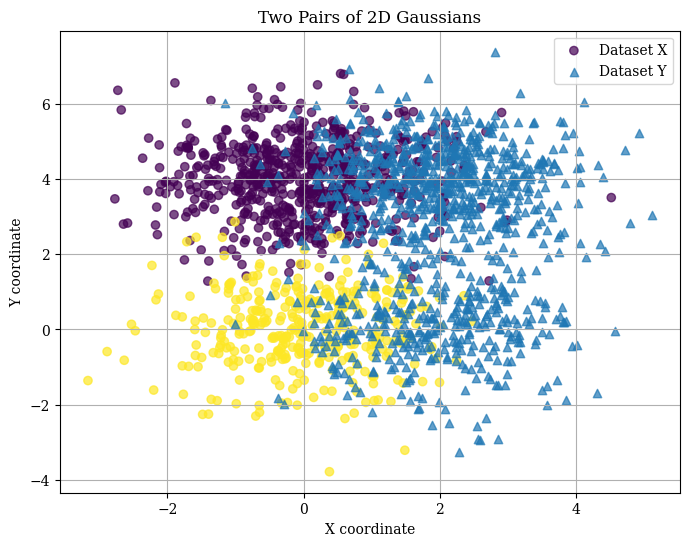

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


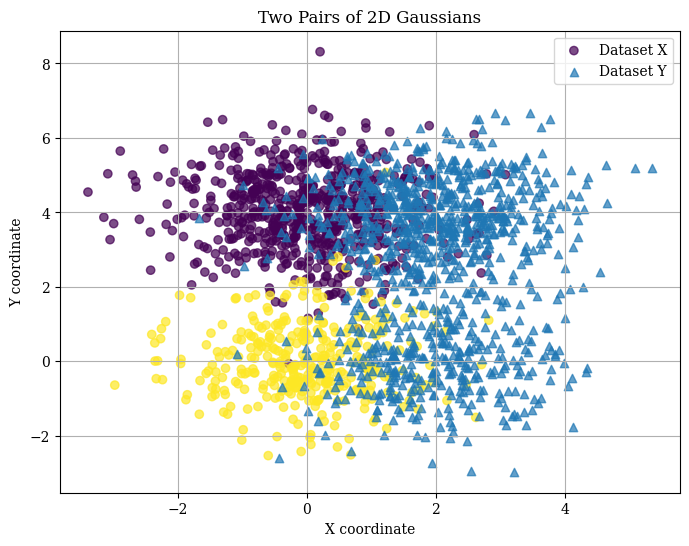

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


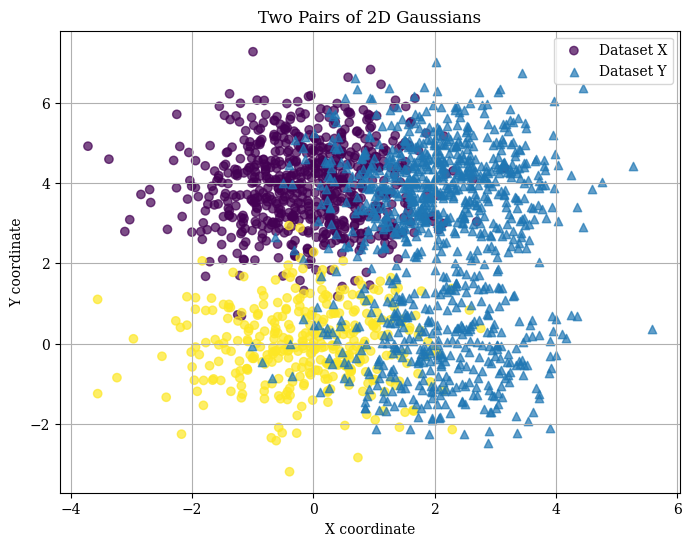

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


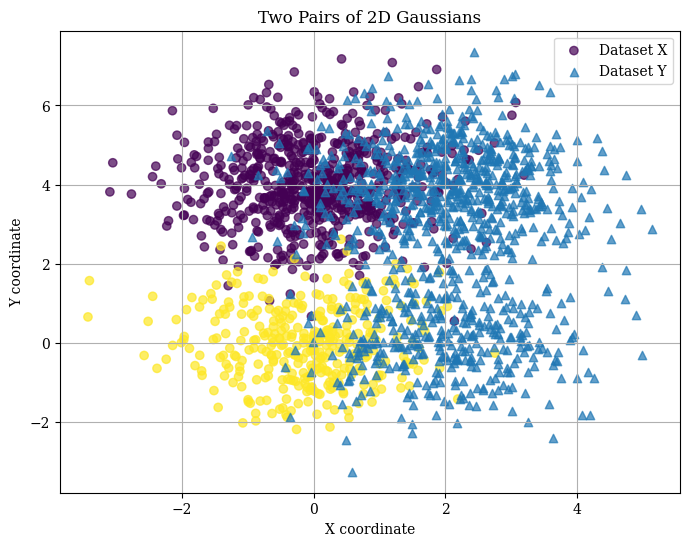

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


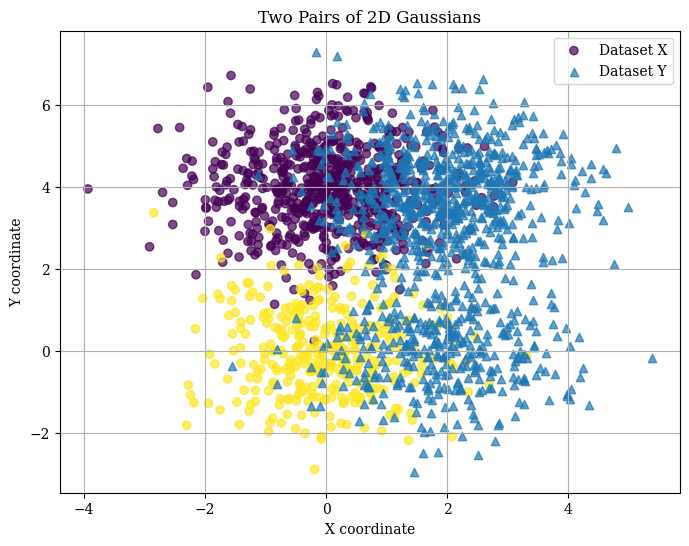

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Points in dataset 1: 700, in dataset 2: 300


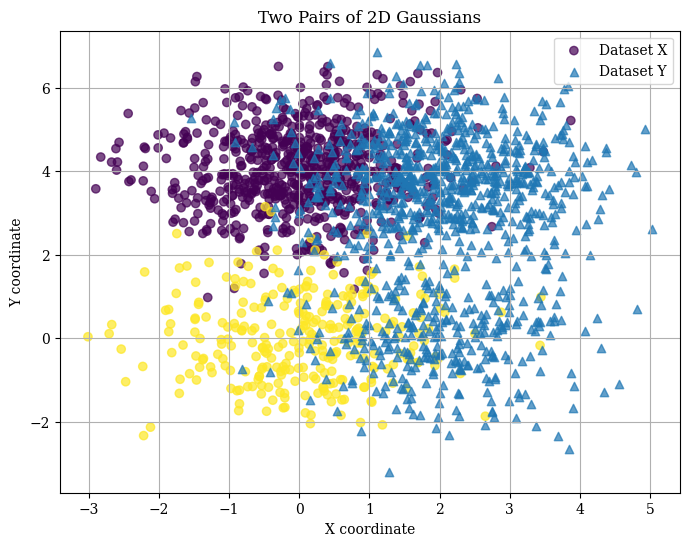

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


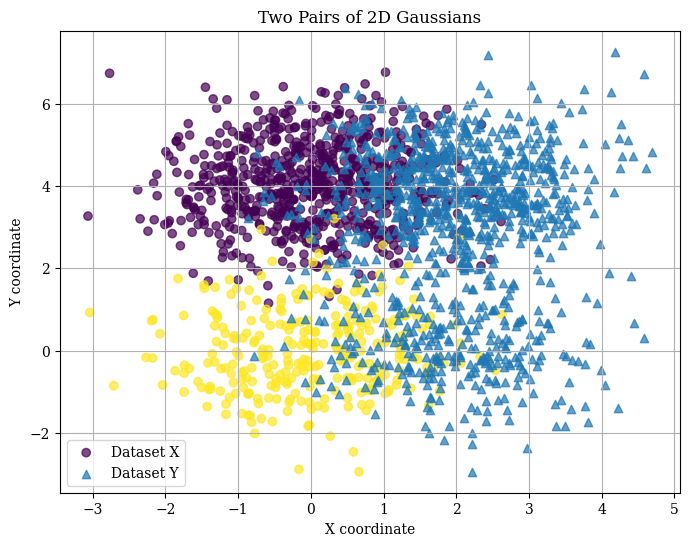

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


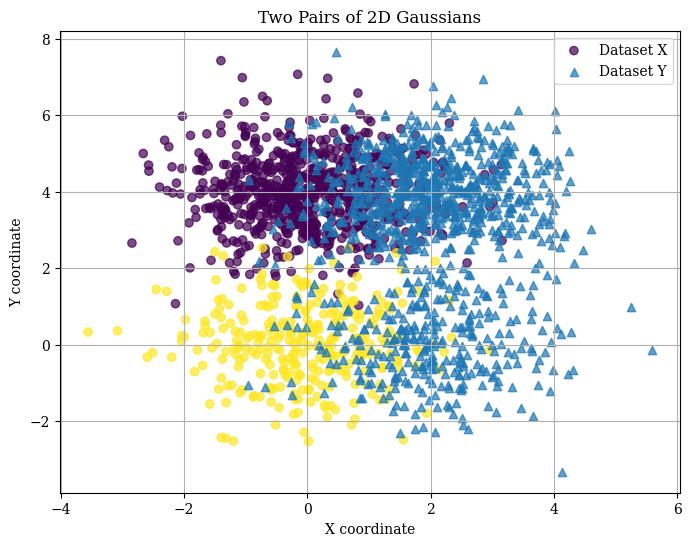

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


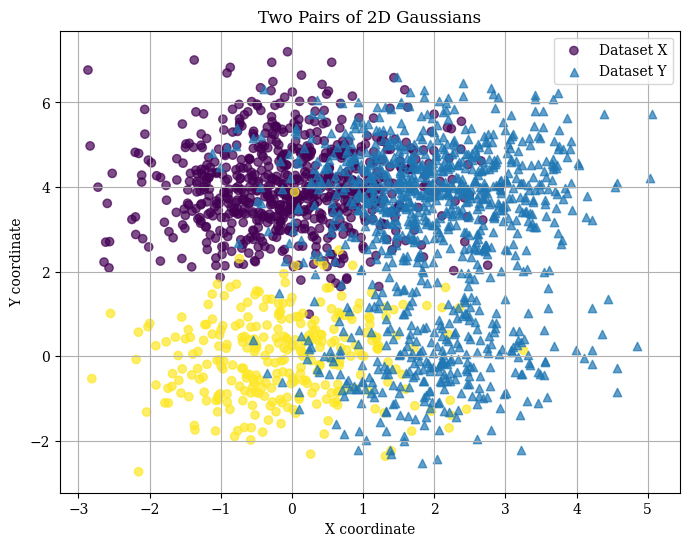

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


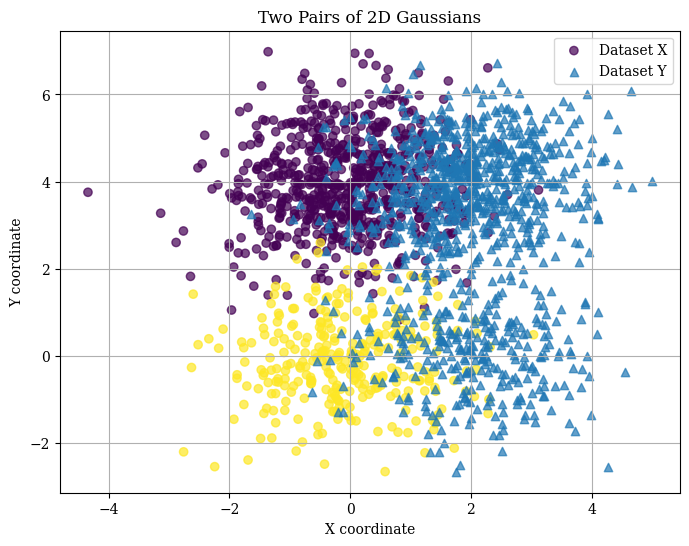

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


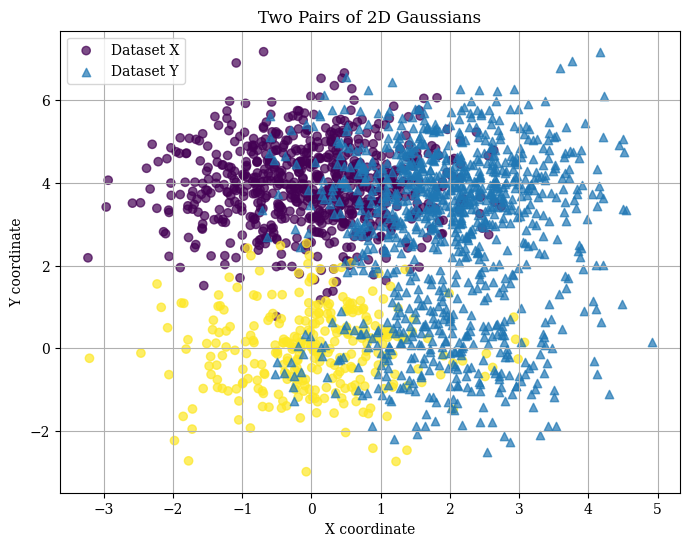

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


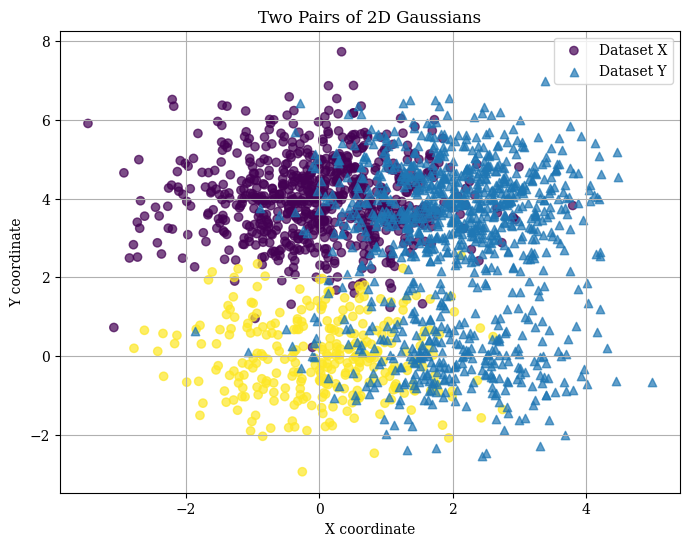

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


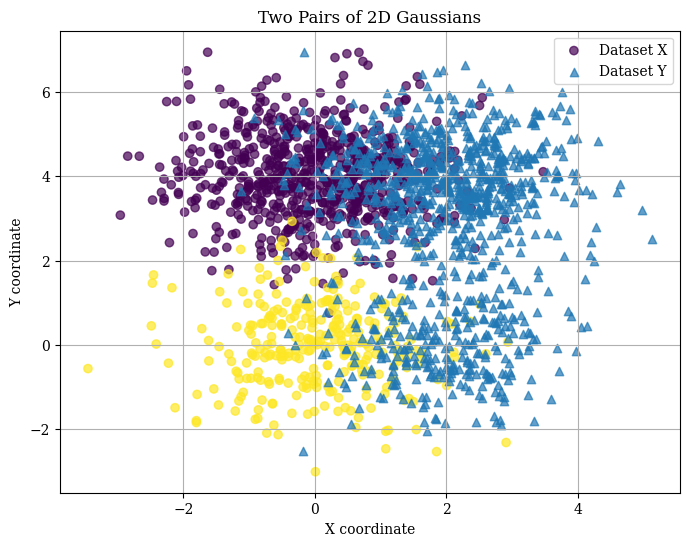

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


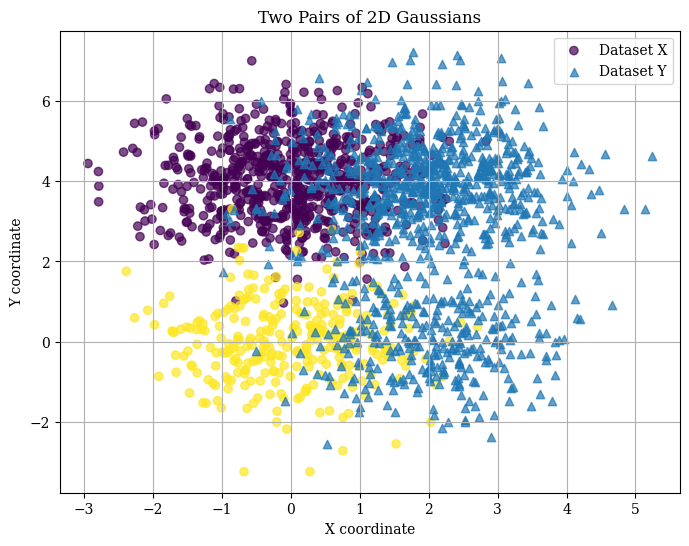

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


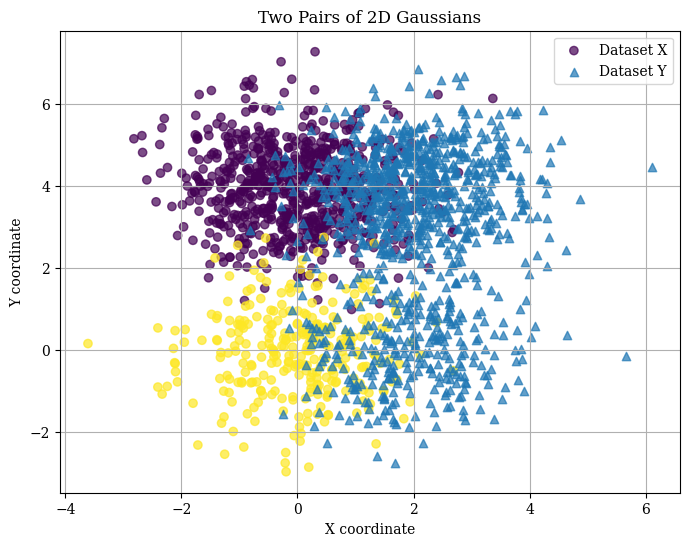

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Points in dataset 1: 750, in dataset 2: 250


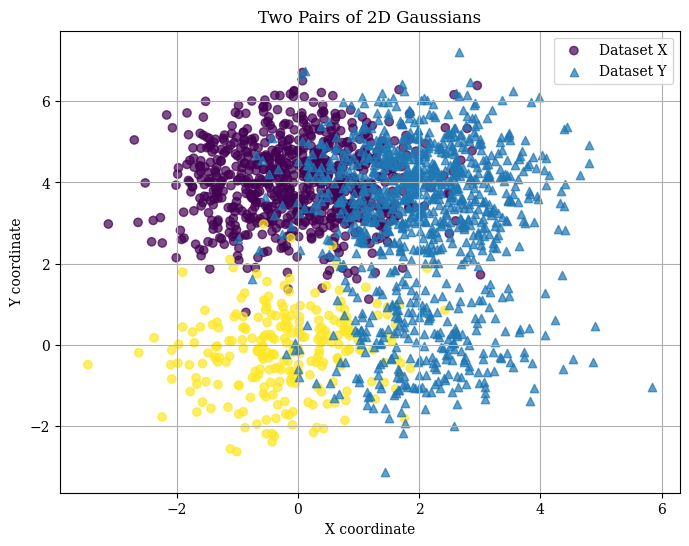

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


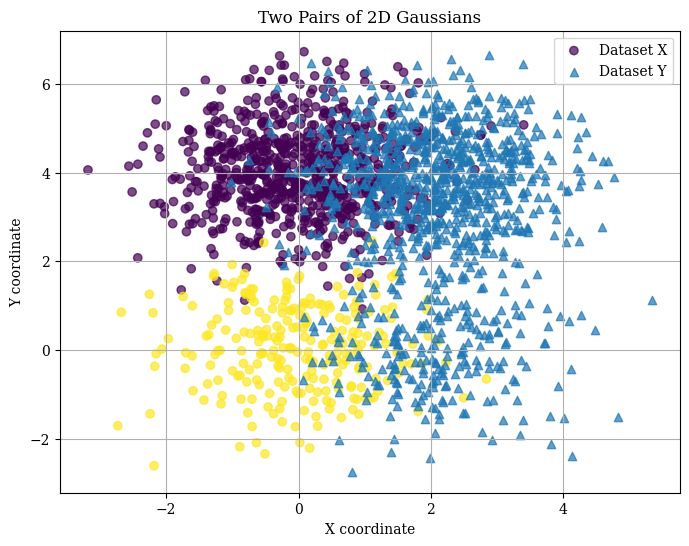

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


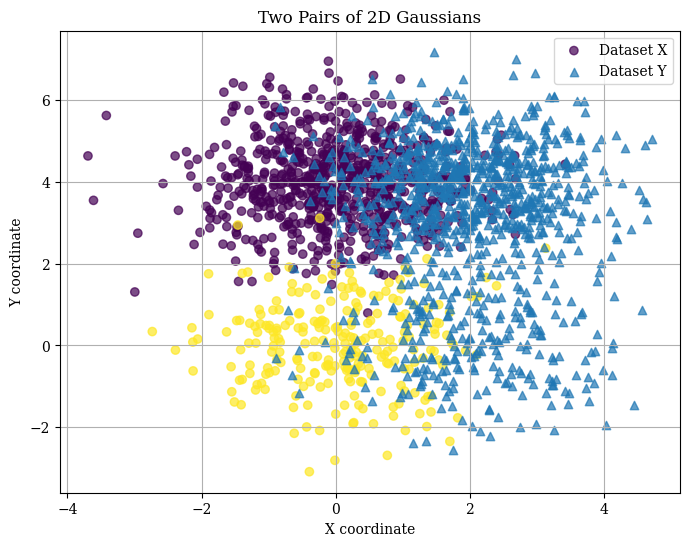

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


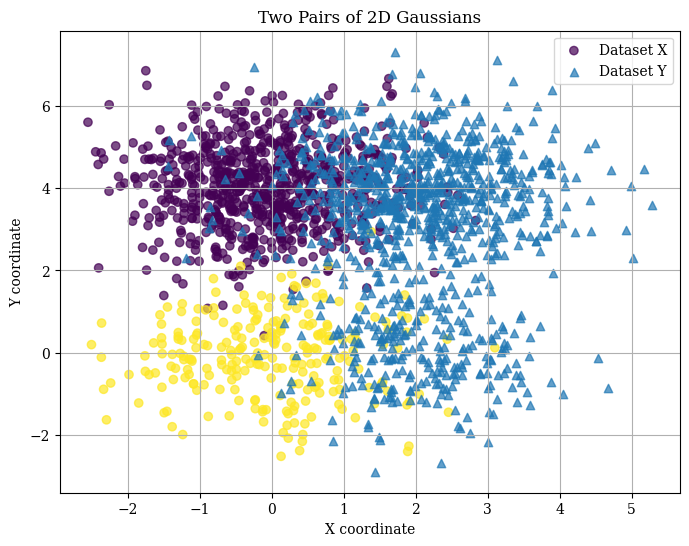

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


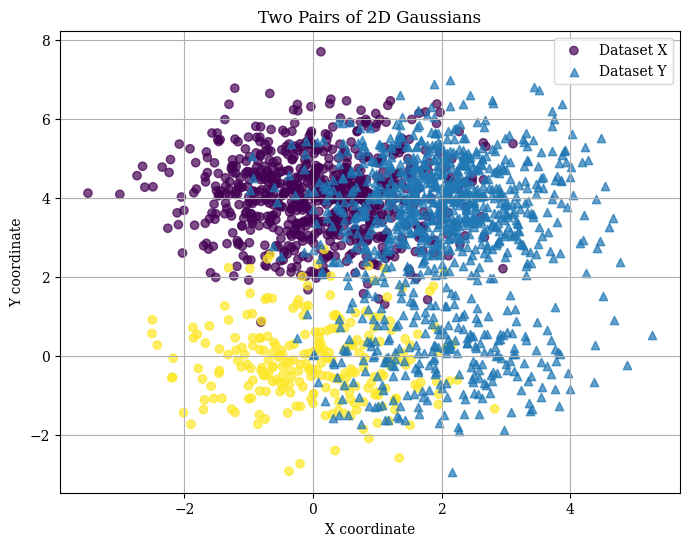

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


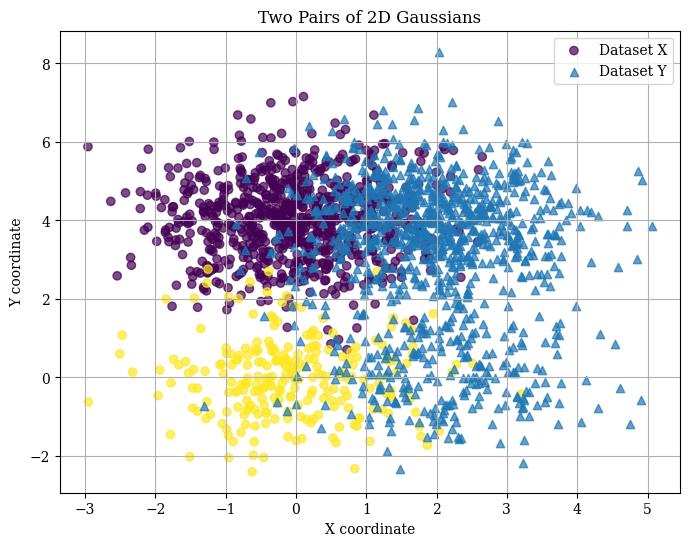

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


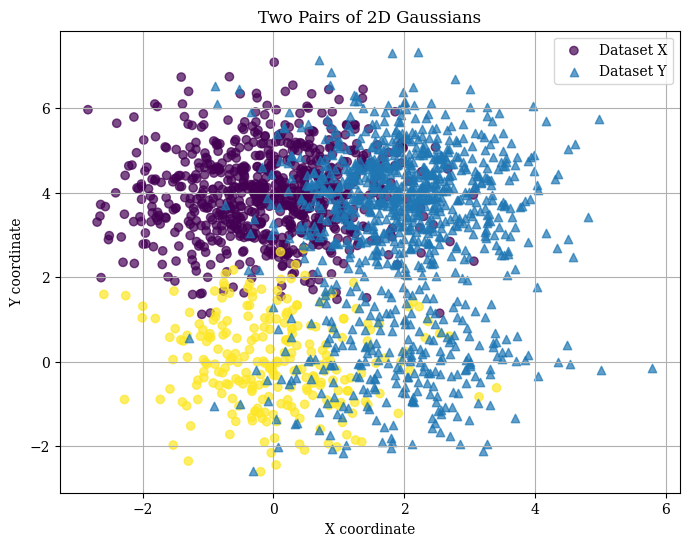

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


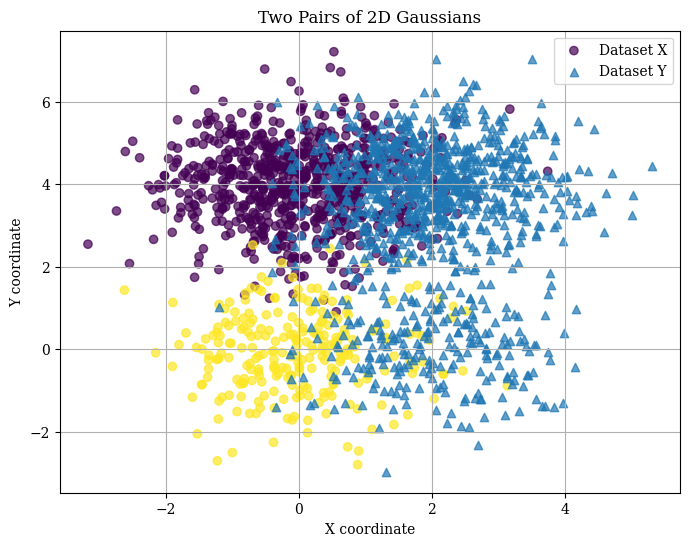

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


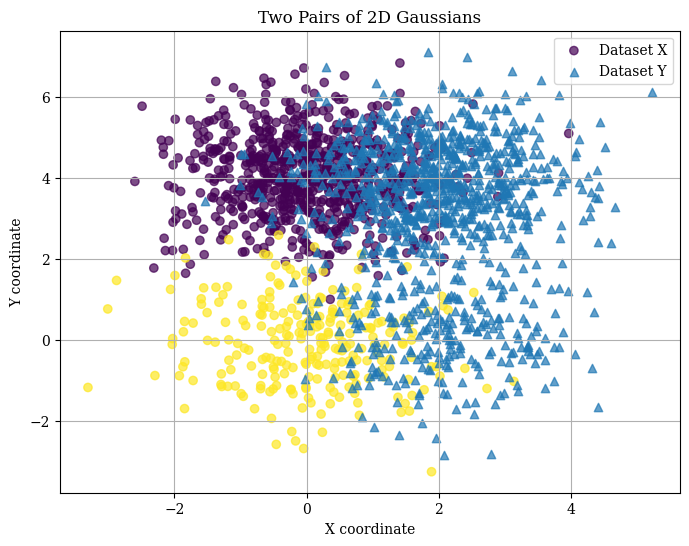

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


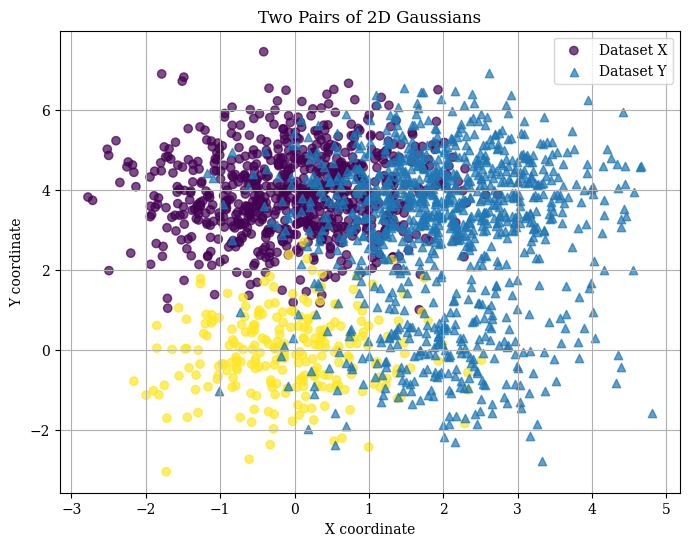

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Points in dataset 1: 800, in dataset 2: 200


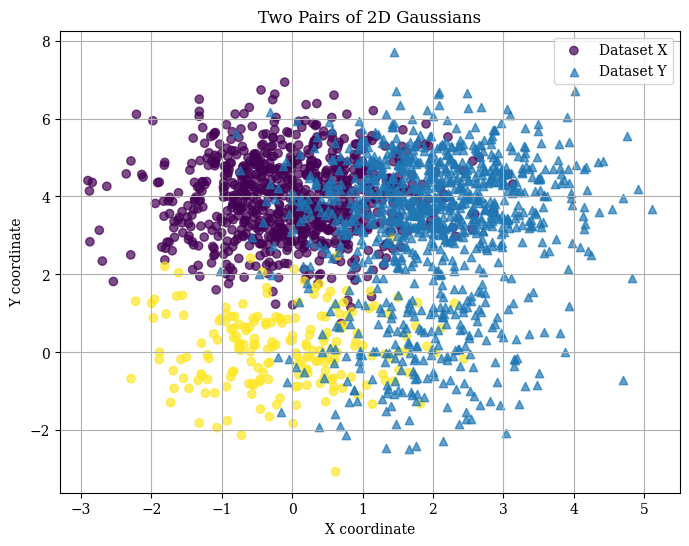

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


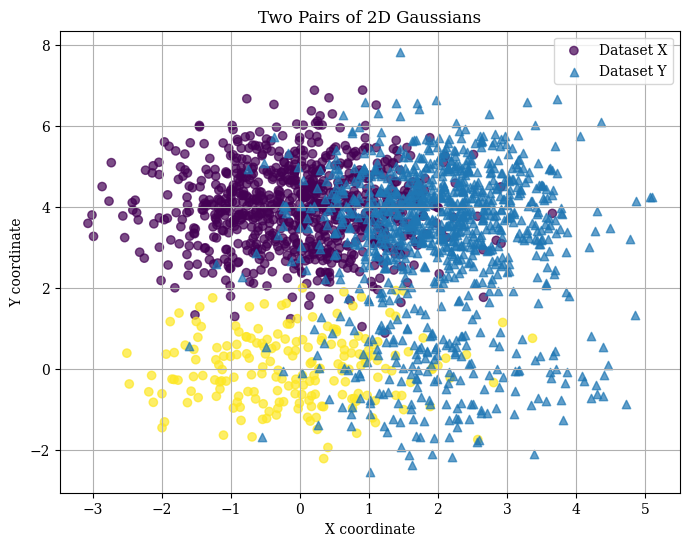

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


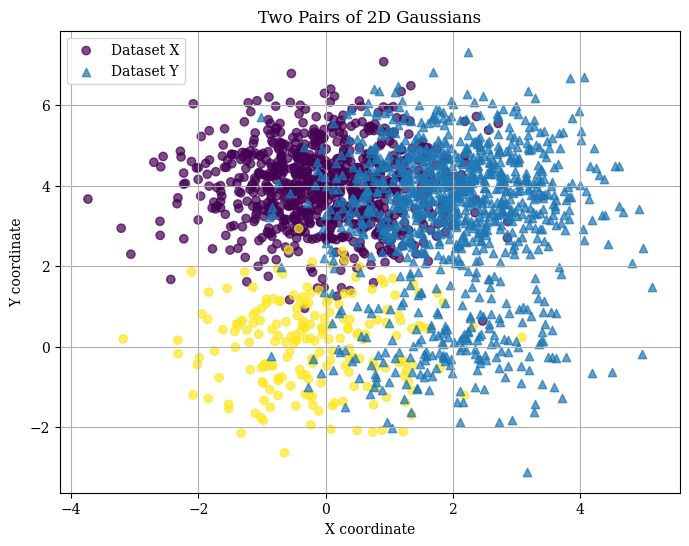

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


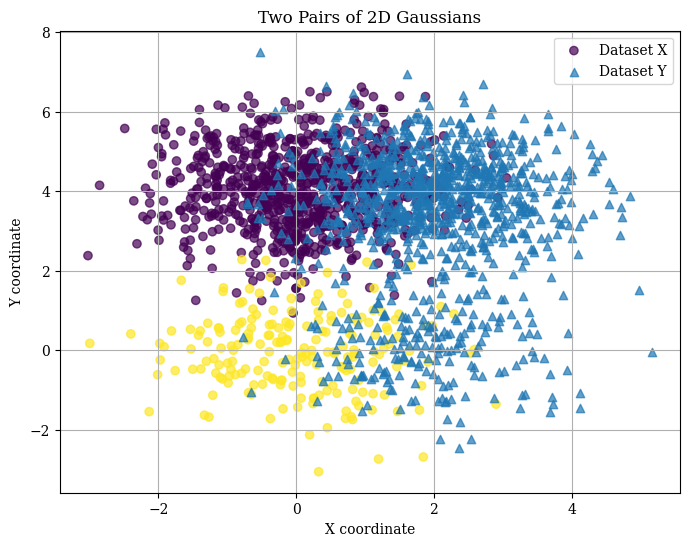

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


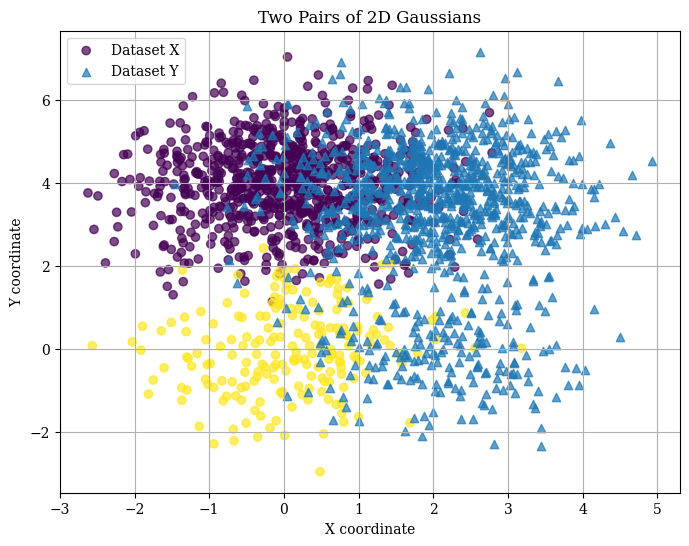

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


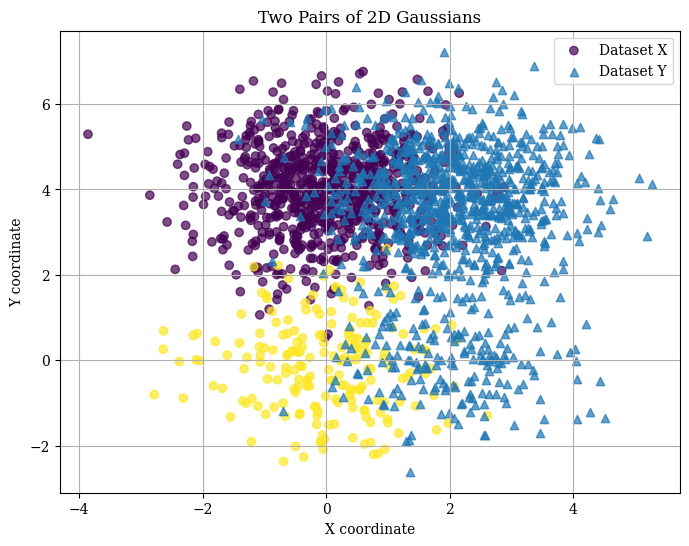

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


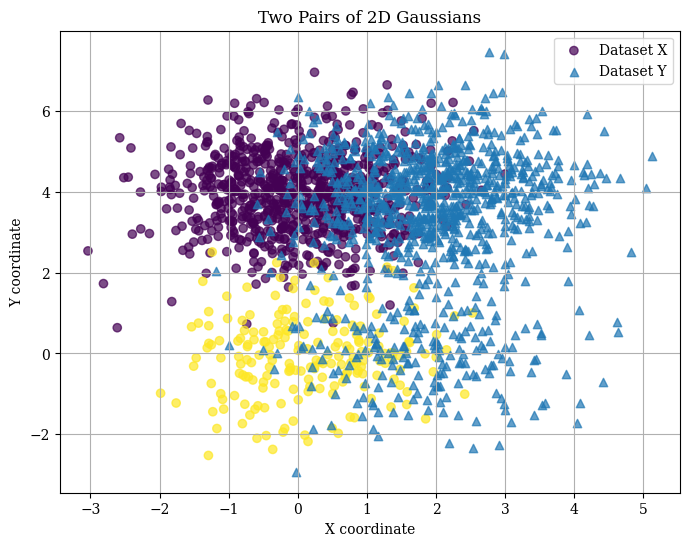

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


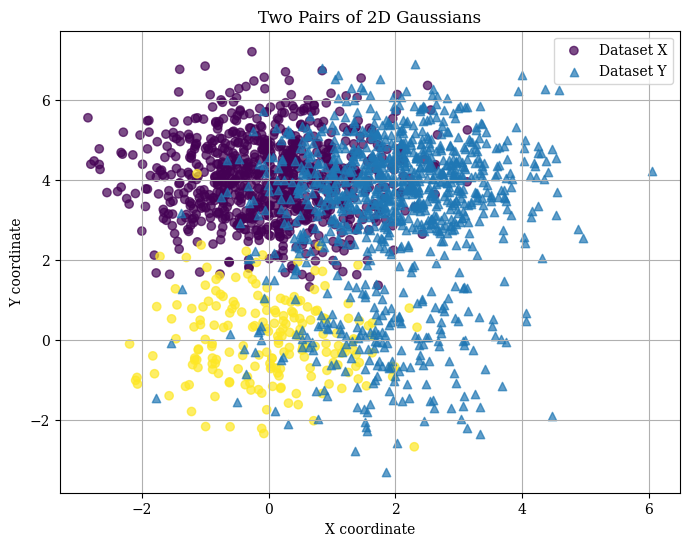

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


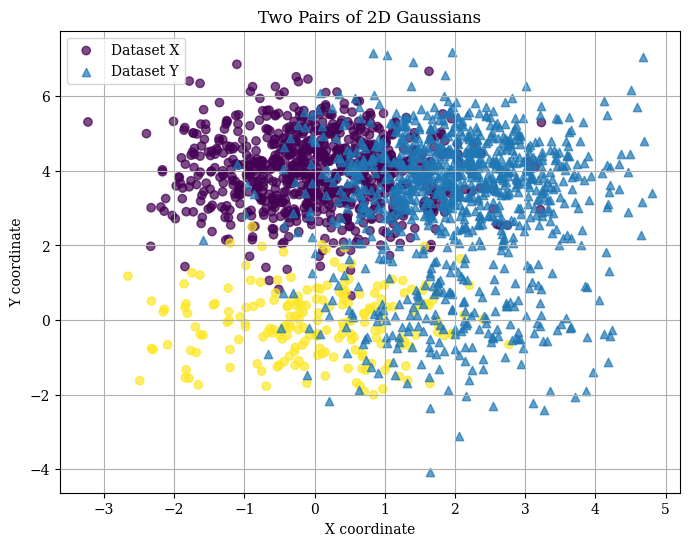

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


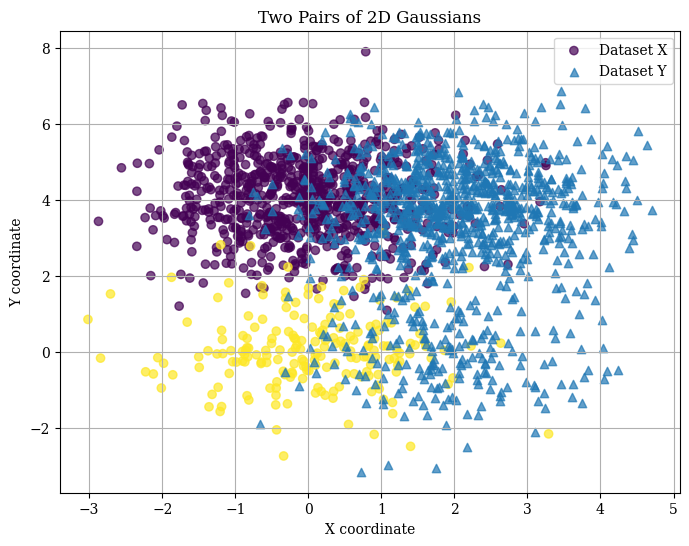

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Points in dataset 1: 850, in dataset 2: 150


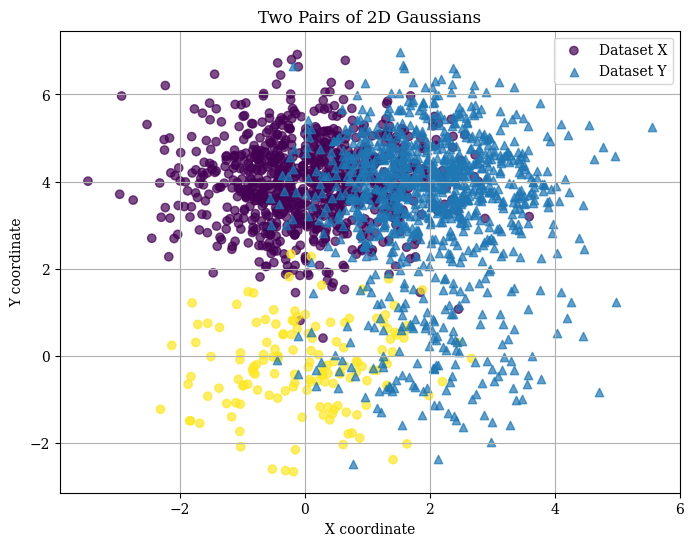

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


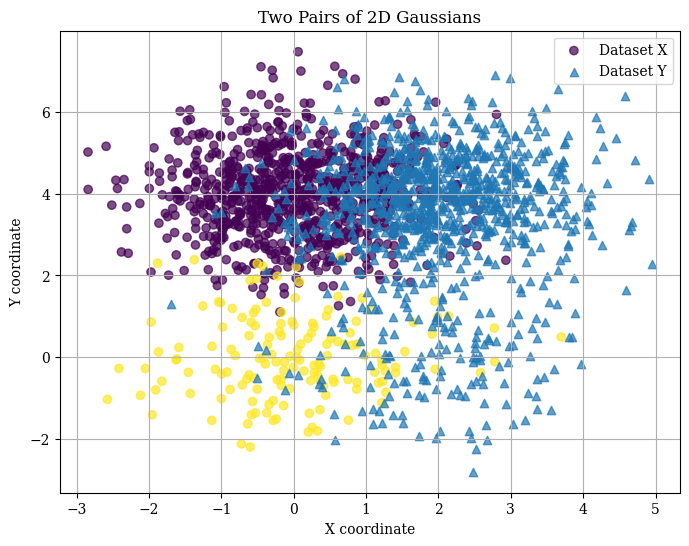

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


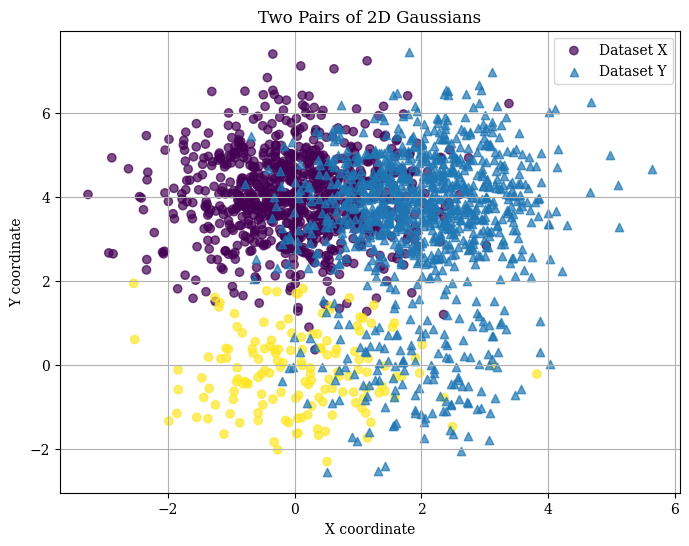

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


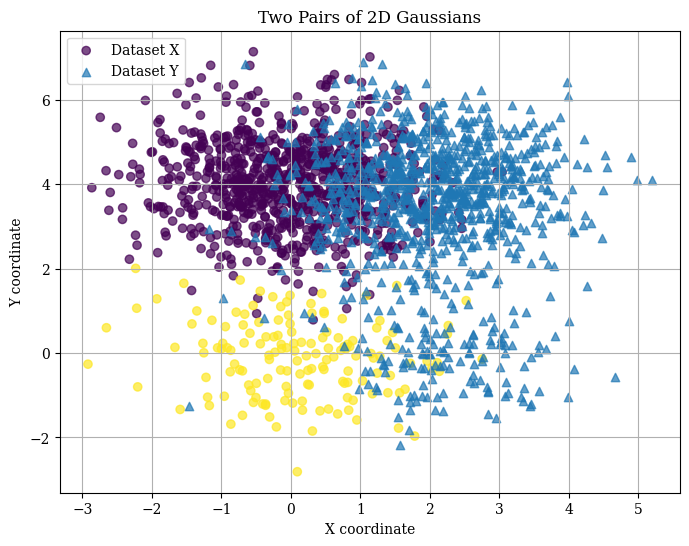

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


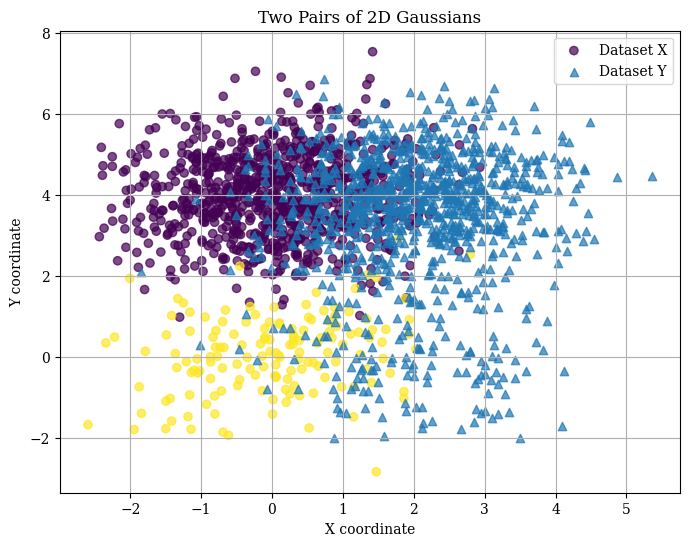

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


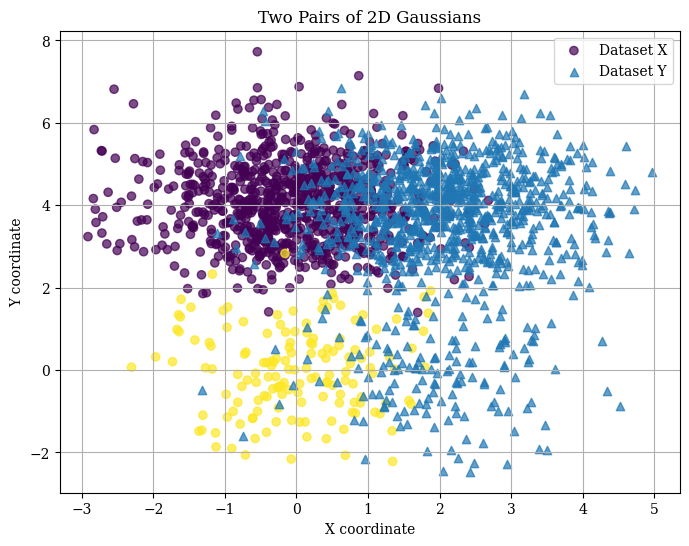

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


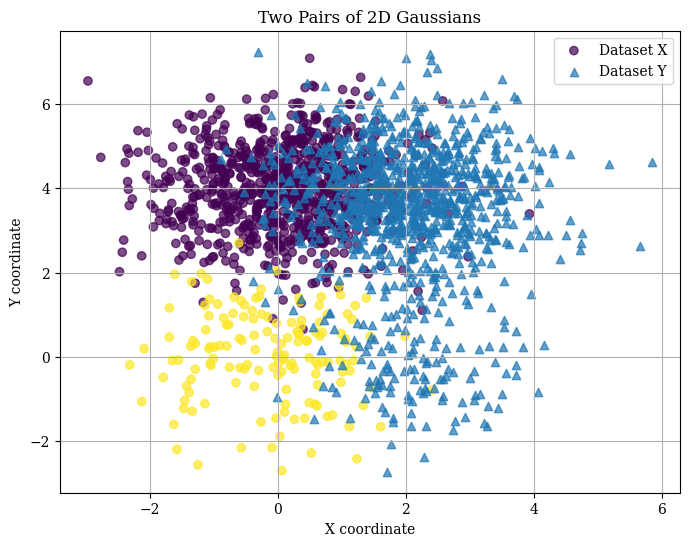

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


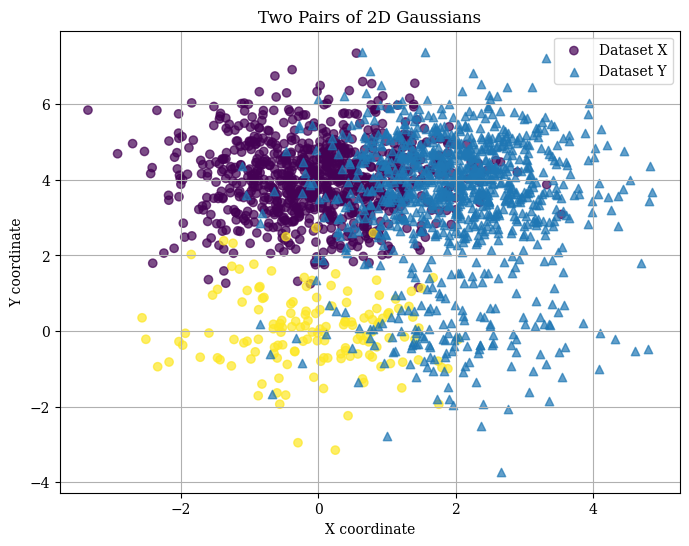

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


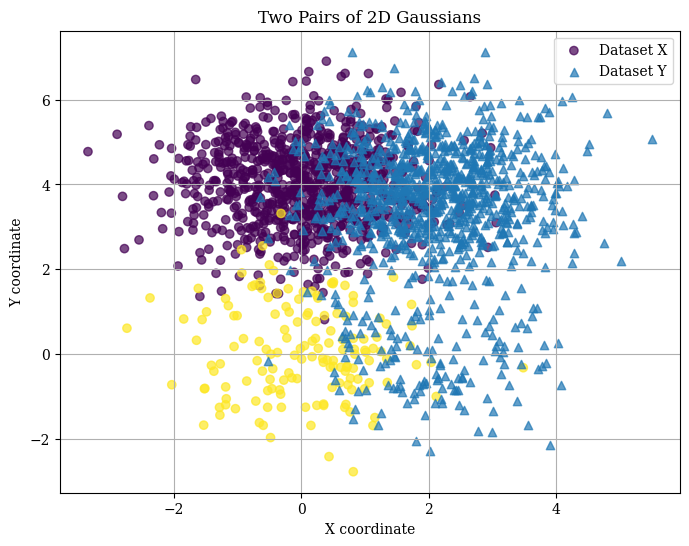

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


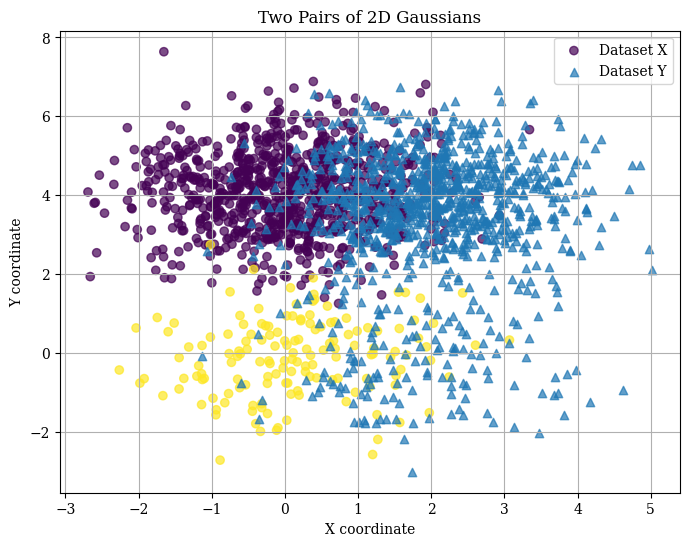

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Points in dataset 1: 900, in dataset 2: 100


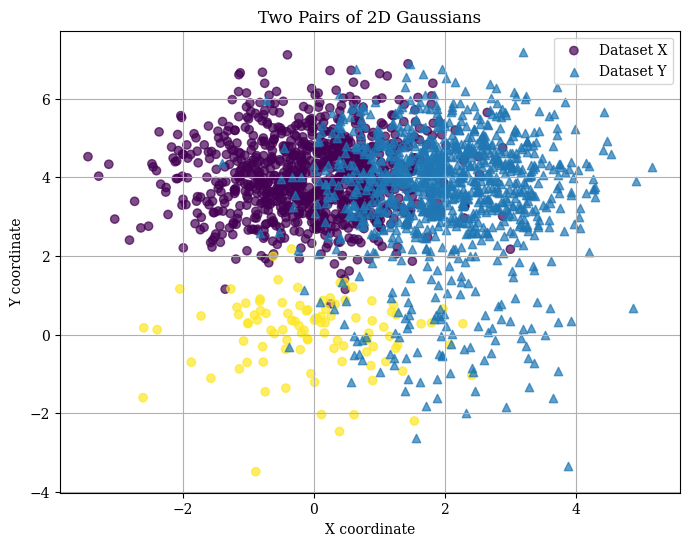

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


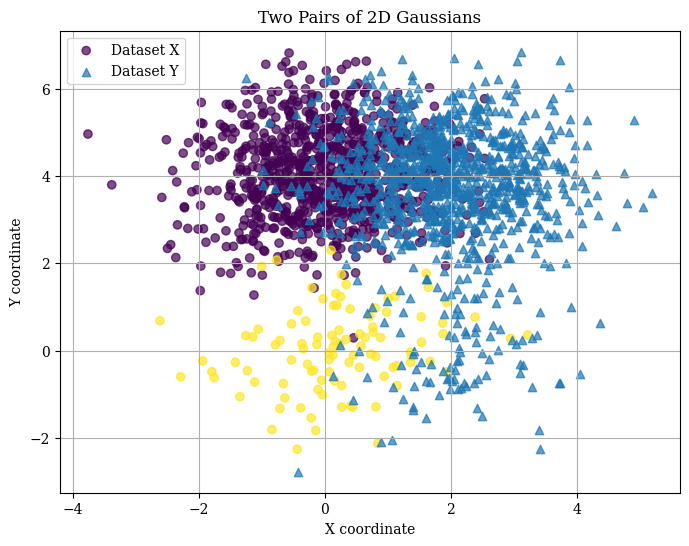

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


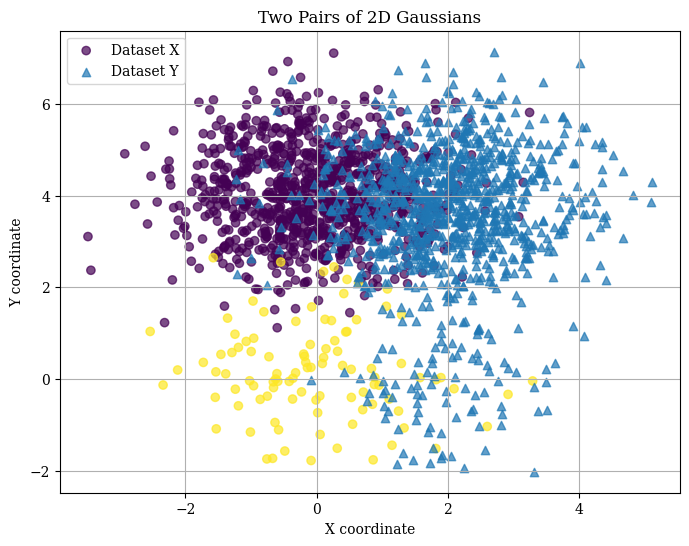

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


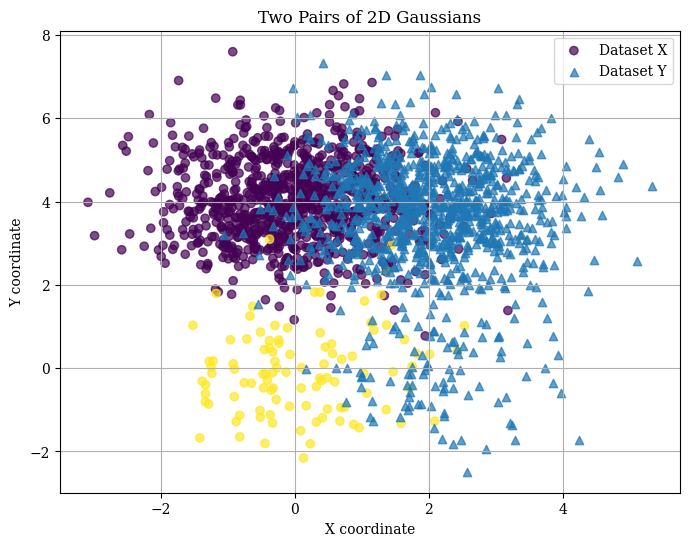

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


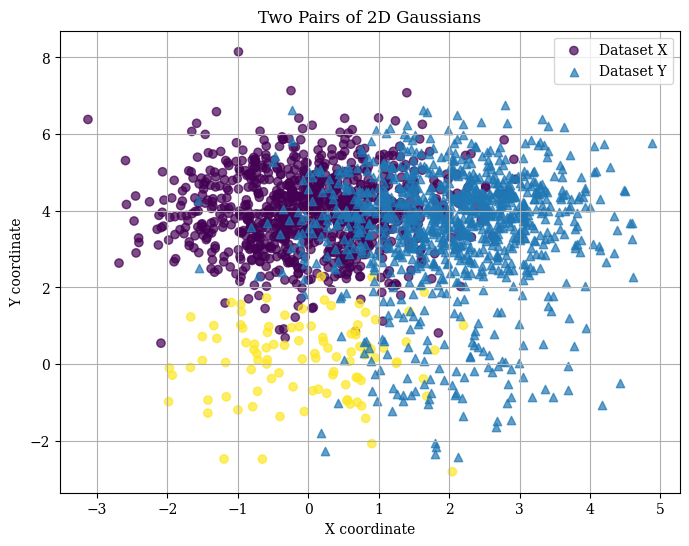

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


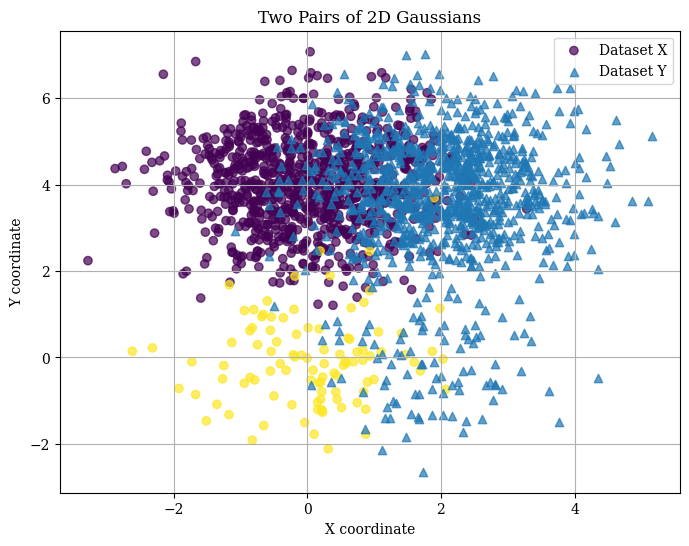

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


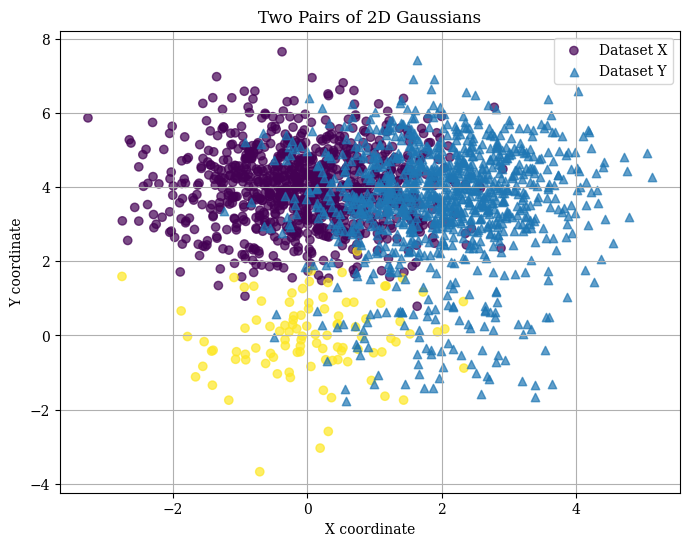

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


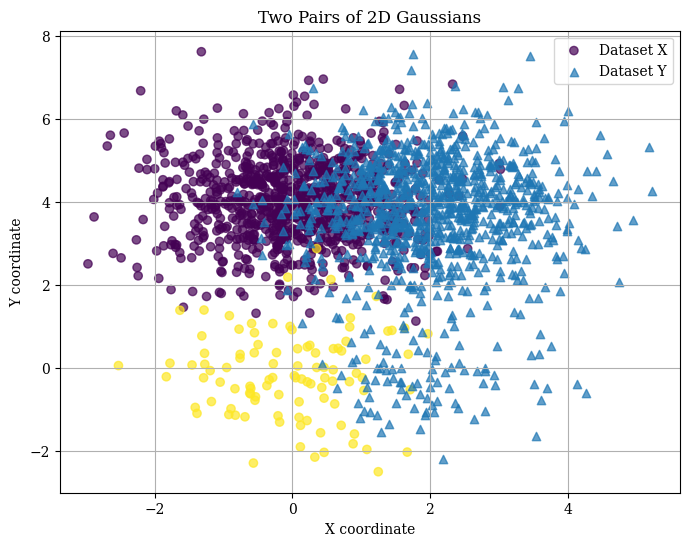

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


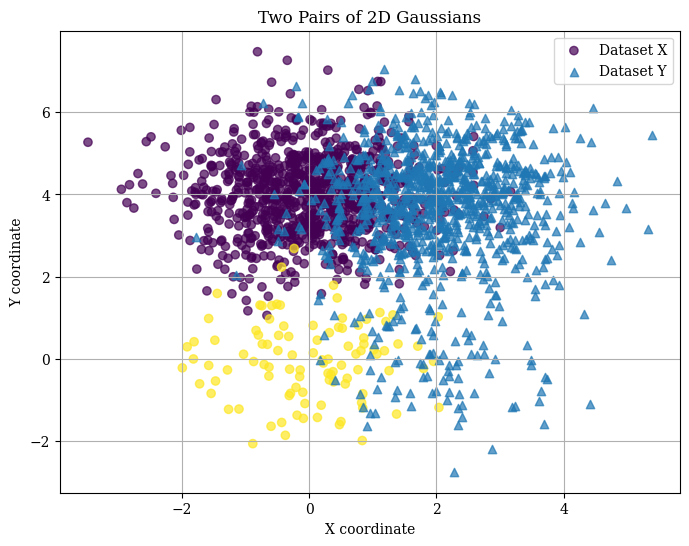

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


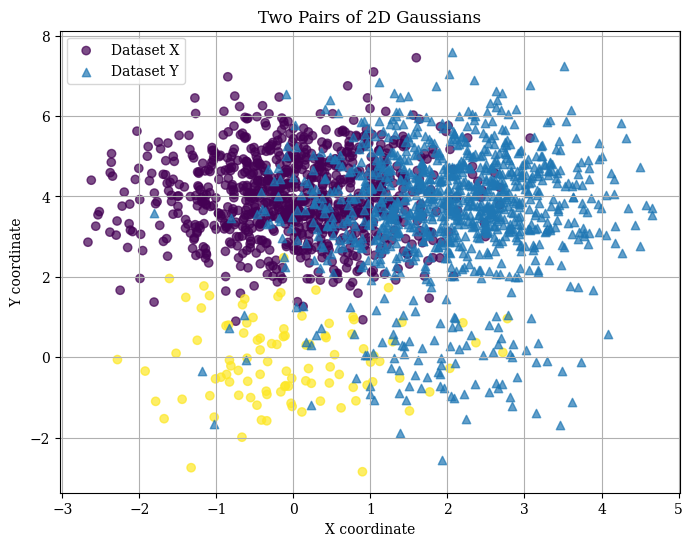

Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0
Iteration: 0


In [8]:

results = {'gmm': [], 'supervised_frlc': [], 'uniform_frlc': [], 'unsupervised_frlc': []}

# 10 runs/replicates
K=10
# Fixed offset of z = 4, t = 2
z, t = 4, 2
# 1000 points total
n = 1000

# Varied cluster proportions
lambds = [0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9]
best_taus = []

# Unit variances for N(0,1)
cov1, cov2 = np.eye(2) , np.eye(2)

for lambd in lambds:
    # Set dataset sizes based on cluster proportions
    n1 = int(lambd*n)
    n2 = n-n1
    
    print(f'Points in dataset 1: {n1}, in dataset 2: {n2}')

    # Define mixture params
    mean_top, mean_bottom = np.array([0.0, z]), np.array([0.0, 0.0])
    shift = np.array([t, 0.0])

    gmm_ami, gmm_ari = [], []
    super_ami, super_ari = [], []
    unif_ami, unif_ari = [], []
    unsup_ami, unsup_ari = [], []
    
    for _ in range(K):
        
        X, Y, true_labels = generate_gaussian_mixture(n1, n2, mean_top, mean_bottom, cov1, cov2, shift)

        # GMM Clustering result
        ami, ari = apply_gmm_clustering(X, true_labels)
        gmm_ami.append(ami)
        gmm_ari.append(ari)

        # Define mixture proportions
        p = max([lambd, 1-lambd])
        _1mp = 1-p

        # Supervised on the GT marginal
        ami, ari = apply_frlc_clustering(X, Y, true_labels, device, \
                                                 gQ=torch.tensor([p, _1mp]).float().to(device), \
                                         gR=torch.tensor([p, _1mp]).float().to(device))
        super_ami.append(ami)
        super_ari.append(ari)

        # Uniform marginal default
        ami, ari = apply_frlc_clustering(X, Y, true_labels, device)
        unif_ami.append(ami)
        unif_ari.append(ari)
        
        # Unsupervised + a minimal grid-search over tau_in
        best_ami = -1
        best_ari = -1
        best_tau = 0
        
        for tau in tau_ins:
            ami, ari = apply_frlc_clustering(X, Y, true_labels, device, tau_in=tau)
            if ami > best_ami:
                best_ami = ami
                best_ari = ari
                best_tau = tau
        
        unsup_ami.append(best_ami)
        unsup_ari.append(best_ari)
        
        if _ == 0:
            best_taus.append(best_tau)
    
    results['gmm'].append((np.mean(gmm_ami), np.mean(gmm_ari)))
    results['supervised_frlc'].append((np.mean(super_ami), np.mean(super_ari)))
    results['uniform_frlc'].append((np.mean(unif_ami), np.mean(unif_ari)))
    results['unsupervised_frlc'].append((np.mean(unsup_ami), np.mean(unsup_ari)))



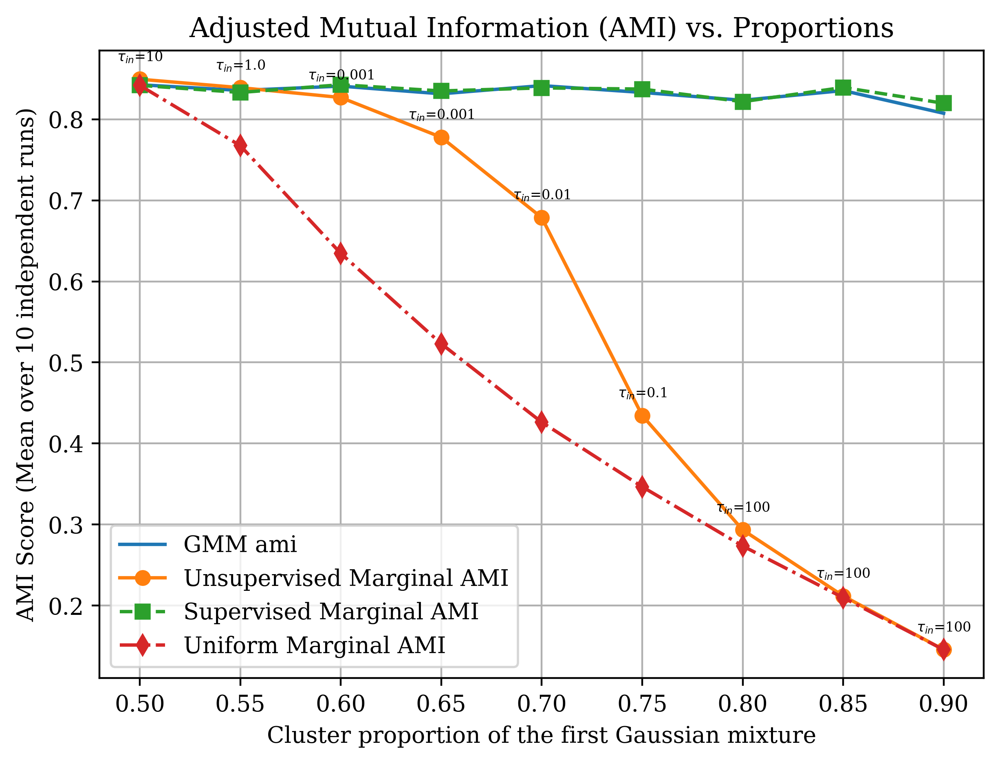

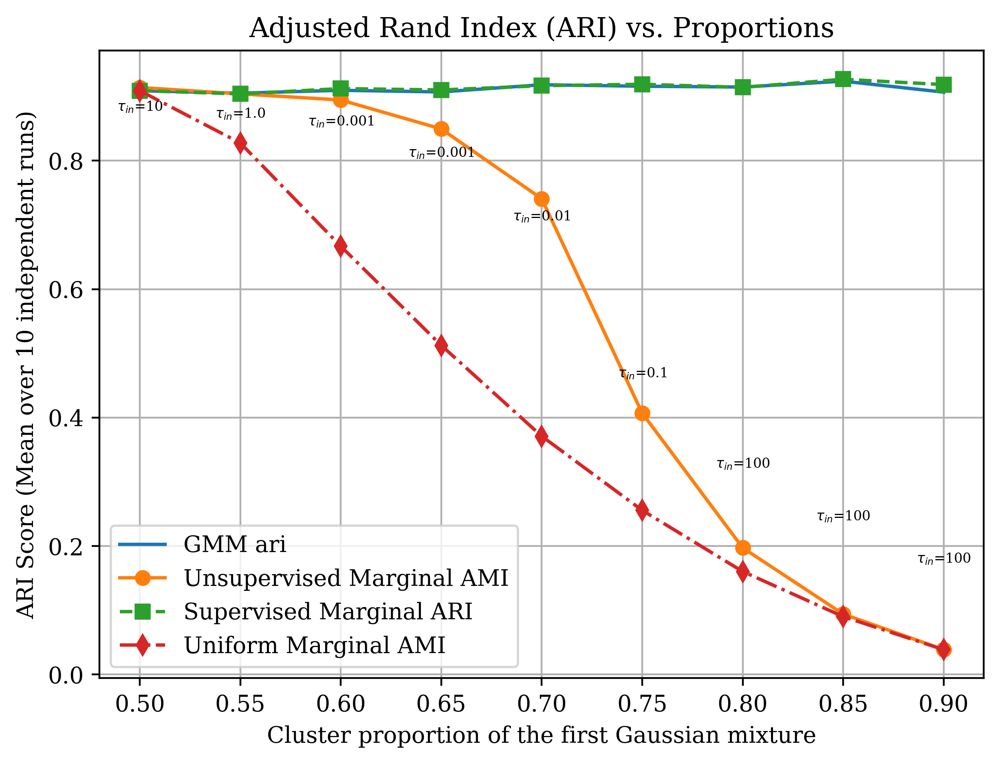

In [9]:
import matplotlib as mpl
#mpl.rcParams['text.usetex'] = True
#mpl.rcParams['font.family'] = 'serif'

plt.figure(figsize=(7, 5), dpi=400)

plt.plot(lambds, np.array(results['gmm'])[:,0], label='GMM ami')
plt.plot(lambds, np.array(results['unsupervised_frlc'])[:,0], marker='o', linestyle='-', label='Unsupervised Marginal AMI')
plt.plot(lambds, np.array(results['supervised_frlc'])[:,0], marker='s', linestyle='--', label='Supervised Marginal AMI')
plt.plot(lambds, np.array(results['uniform_frlc'])[:,0], marker='d', linestyle='-.', label='Uniform Marginal AMI')

# Annotate best hyperparameters
for i, txt in enumerate(best_taus):
    plt.annotate(r"$\tau_{in}$="+f"{txt}", (lambds[i], np.array(results['unsupervised_frlc'])[i, 0]), 
                 textcoords="offset points", xytext=(0, 8), ha='center', fontsize=6, color='black')

plt.xlabel("Cluster proportion of the first Gaussian mixture")
plt.ylabel(f"AMI Score (Mean over {K} independent runs)")
plt.title("Adjusted Mutual Information (AMI) vs. Proportions")
plt.legend()
plt.grid(True)
plt.savefig("AMI_GaussMix_prop.pdf", bbox_inches='tight')
plt.show()

# Improved Plot for ARI
plt.figure(figsize=(7, 5), dpi=400)
plt.plot(lambds, np.array(results['gmm'])[:,1], label='GMM ari')
plt.plot(lambds, np.array(results['unsupervised_frlc'])[:,1], marker='o', linestyle='-', label='Unsupervised Marginal AMI')
plt.plot(lambds, np.array(results['supervised_frlc'])[:,1], marker='s', linestyle='--', label='Supervised Marginal ARI')
plt.plot(lambds, np.array(results['uniform_frlc'])[:,1], marker='d', linestyle='-.', label='Uniform Marginal AMI')

# Annotate best hyperparameters
for i, txt in enumerate(best_taus):
    plt.annotate(r"$\tau_{in}$="+f"{txt}", (lambds[i], np.array(results['unsupervised_frlc'])[i, 0]), 
                 textcoords="offset points", xytext=(0, 8), ha='center', fontsize=6, color='black')

plt.xlabel("Cluster proportion of the first Gaussian mixture")
plt.ylabel(f"ARI Score (Mean over {K} independent runs)")
plt.title("Adjusted Rand Index (ARI) vs. Proportions")
plt.legend()
plt.grid(True)
plt.savefig("ARI_GaussMix_prop.pdf", bbox_inches='tight')
plt.show()